# Generative Adversarial Network (GAN)

![](https://nbviewer.jupyter.org/github/hse-aml/intro-to-dl/blob/master/week4/images/gan.png)

Пришло время поговорить о более интересных архитектурах, а именно о GANах или состязательных нейронных сетках. [Впервые GANы были предложены в 2014 году.](https://arxiv.org/abs/1406.2661) Сейчас они очень активно исследуются. GANы состоят из двух нейронных сетей: 

* Первая - генератор порождает из некоторого заданного распределения случайные числа и собирает из них объекты, которые идут на вход второй сети. 
* Вторая - дискриминатор получает на вход объекты из реальной выборки и объекты, созданные генератором. Она пытается определить какой объект был порождён генератором, а какой является реальным.

Таким образом генератор пытается создавать объекты, которые дискриминатор не сможет отличить от реальных. 

### Цель
В этом ноутбуке мы создадим свой первый GAN, а именно мы построим и обучим GAN, который генерирует рукописные цифры.

### План
1.   Построить генератор и дискриминатор с нуля
2.   Написать лосс функции для генератора и дискриминатора
3.   Обучить GAN и визуализировать сгенерированные изображения
4.   Обучить  Deep Convolutional GAN (DCGAN), очень успешный GAN, созданный в 2015


### Совет
При обучении может возникнуть огромное количество пробем от взрыва весов до более тонких вещей. Имеет смысл посмотреть на [разные трюки](https://github.com/soumith/ganhacks), используемые при обучении.


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

%cd /content/gdrive/My Drive/HSE_DL_2021/10_week

Mounted at /content/gdrive
/content/gdrive/My Drive/HSE_DL_2021/10_week


In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), dcgan=False):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    if dcgan:
        image_tensor = (image_tensor + 1) / 2
        image_unflat = image_tensor.detach().cpu()
    else:
        image_unflat = image_tensor.detach().cpu().view(-1, *size)

    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

#### MNIST Dataset
Изображения, которые будет использовать дискриминатор в качестве обучения, взяты из набора данных под названием [MNIST](http://yann.lecun.com/exdb/mnist/). Он содержит 60000 изображений рукописных цифр от 0 до 9, например:

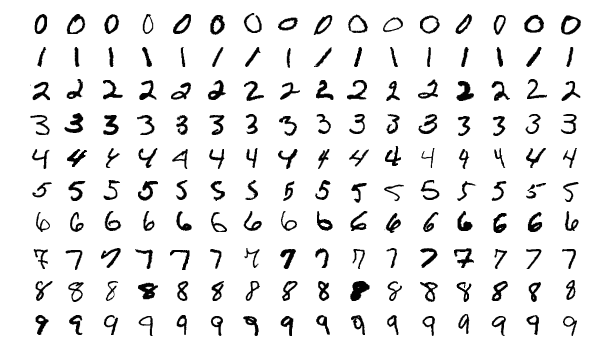

In [ ]:
from IPython.display import Image

Image('images/MnistExamples.png')

## Generator
Первым делом создадим генератор.

Начнем с создания функции для создания одного слоя/блока для нейронной сети генератора. Каждый блок состоит из линейного слоя, батч нормализации и, наконец, нелинейной функции активации.

In [ ]:
def get_generator_block(input_dim, output_dim):
    '''
    Function for returning a block of the generator's neural network
    given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a generator neural network layer, with a linear transformation 
          followed by a batch normalization and then a relu activation
    '''
    return nn.Sequential(
        # Hint: Replace all of the "None" with the appropriate dimensions.
        #### START CODE HERE ####
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        #### END CODE HERE ####
        nn.ReLU(inplace=True)
    )

Теперь вы можете построить класс генератора. Он принимает на вход 3 значения:

*   The noise vector dimension
*   The image dimension
*   The initial hidden dimension

Using these values, the generator will build a neural network with 5 layers/blocks. Beginning with the noise vector, the generator will apply non-linear transformations via the block function until the tensor is mapped to the size of the image to be outputted (the same size as the real images from MNIST).  The final layer does not need a normalization or activation function, but does need to be scaled with a sigmoid function

Finally, you are given a forward pass function that takes in a noise vector and generates an image of the output dimension using your neural network.

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
          (MNIST images are 28 x 28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim * 2),
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),

            #### START CODE HERE ####
            nn.Linear(hidden_dim * 8, im_dim),
            nn.Sigmoid()
            #### END CODE HERE ####
        )
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        '''
        return self.gen(noise)

## Noise
To be able to use your generator, you will need to be able to create noise vectors. The noise vector z has the important role of making sure the images generated from the same class don't all look the same -- think of it as a random seed. You will generate it randomly using PyTorch by sampling random numbers from the normal distribution. Since multiple images will be processed per pass, you will generate all the noise vectors at once.


In [ ]:
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim),
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    # NOTE: To use this on GPU with device='cuda', make sure to pass the device 
    # argument to the function you use to generate the noise.
    #### START CODE HERE ####
    return torch.randn((n_samples, z_dim)).to(device)
    #### END CODE HERE ####

## Discriminator
The second component that you need to construct is the discriminator. As with the generator component, you will start by creating a function that builds a neural network block for the discriminator.

*Note: You use leaky ReLUs to prevent the "dying ReLU" problem, which refers to the phenomenon where the parameters stop changing due to consistently negative values passed to a ReLU, which result in a zero gradient*



In [ ]:
def get_discriminator_block(input_dim, output_dim):
    '''
    Discriminator Block
    Function for returning a neural network of the discriminator given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a discriminator neural network layer, with a linear transformation 
          followed by an nn.LeakyReLU activation with negative slope of 0.2
    '''
    return nn.Sequential(
        #### START CODE HERE ####
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(negative_slope=0.2)  # inplace=True
        #### END CODE HERE ####
    )

Теперь используем написанную функцию для создания дискриминатора. Он принимает на вход 2 значения:

*   The image dimension
*   The hidden dimension

The discriminator will build a neural network with 4 layers. It will start with the image tensor and transform it until it returns a single number (1-dimension tensor) output. This output classifies whether an image is fake or real.

You do not need a sigmoid after the output layer since it is included in the loss function **(BCEWithLogitsLoss)**. Finally, to use your discrimator's neural network you are given a forward pass function that takes in an image tensor to be classified.


In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
            (MNIST images are 28x28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            # Hint: You want to transform the final output into a single value,
            #       so add one more linear map.
            #### START CODE HERE ####
            nn.Linear(hidden_dim, 1)
            #### END CODE HERE ####
        )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        '''
        return self.disc(image)

## Training GAN
Now you can put it all together!
First, you will set your parameters:
  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type, here using a GPU (which runs CUDA), not CPU

Next, you will load the MNIST dataset as tensors using a dataloader.



In [ ]:
# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001

# Load MNIST dataset as tensors
dataloader = DataLoader(
    MNIST('.', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

### DO NOT EDIT ###
device = 'cuda'

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Now, you can initialize your generator, discriminator, and optimizers. Note that each optimizer only takes the parameters of one particular model, since we want each optimizer to optimize only one of the models.

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)

disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Before you train your GAN, you will need to create functions to calculate the discriminator's loss and the generator's loss. This is how the discriminator and generator will know how they are doing and improve themselves. 

Remember to call `.detach()` on the generator result to ensure that only the discriminator is updated. This is important due to the fact that the generator is needed when calculating the discriminator's loss!


In [ ]:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch (num_images) of fake images. 
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image 
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a 
    #            'ground truth' tensor in order to calculate the loss. 
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #### START CODE HERE ####
    noise = get_noise(num_images, z_dim, device=device)
    fake = gen(noise).detach()
    
    pred_of_fake = disc(fake)
    loss_fake = criterion(pred_of_fake, torch.zeros_like(pred_of_fake))

    pred_of_real = disc(real)
    loss_real = criterion(pred_of_real, torch.ones_like(pred_of_real))
    
    disc_loss = (loss_fake + loss_real) / 2
    #### END CODE HERE ####
    return disc_loss

In [ ]:
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images. 
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real

    #### START CODE HERE ####
    noise = get_noise(num_images, z_dim, device=device)
    fake = gen(noise)
    
    pred_of_fake = disc(fake)
    gen_loss = criterion(pred_of_fake, torch.ones_like(pred_of_fake))

    #### END CODE HERE ####
    return gen_loss

Finally, you can put everything together! 

It’s also often the case that the discriminator will outperform the generator, especially at the start, because its job is easier. It's important that neither one gets too good (that is, near-perfect accuracy), which would cause the entire model to stop learning. Balancing the two models is actually remarkably hard to do in a standard GAN.

You should roughly expect to see this progression. On a GPU, this should take about 15 seconds per 500 steps, on average, while on CPU it will take roughly 1.5 minutes:

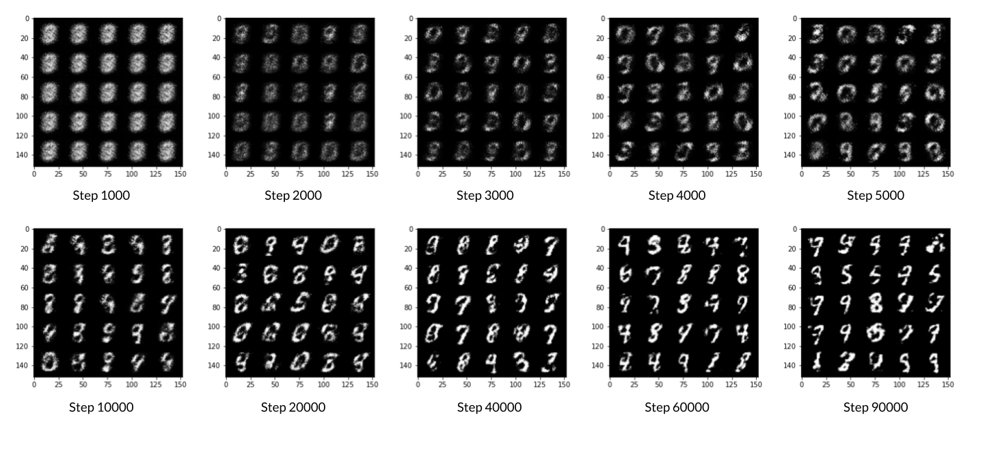

In [ ]:
Image('images/MNIST_res.png')

  0%|          | 0/200 [00:00<?, ?it/s]

Step 500: Generator loss: 1.3881, discriminator loss: 0.4194


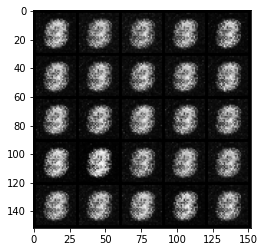

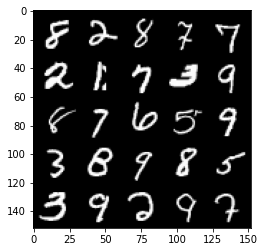

Step 1000: Generator loss: 1.6660, discriminator loss: 0.3018


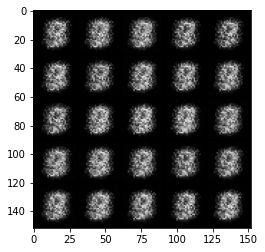

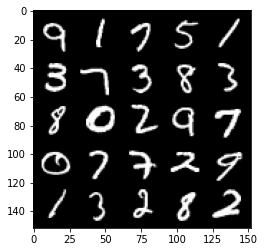

Step 1500: Generator loss: 1.9583, discriminator loss: 0.1760


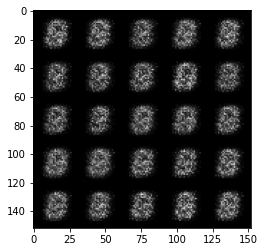

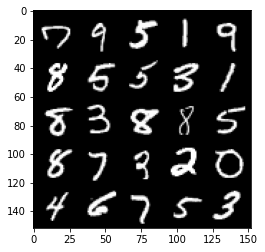

Step 2000: Generator loss: 1.7628, discriminator loss: 0.1971


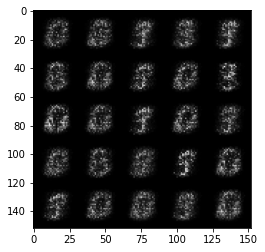

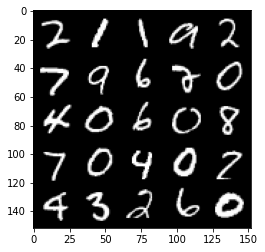

Step 2500: Generator loss: 1.7454, discriminator loss: 0.1913


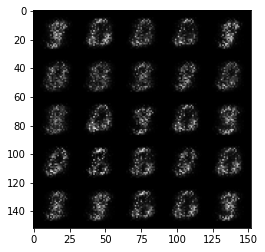

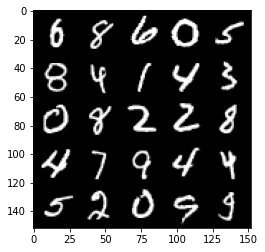

Step 3000: Generator loss: 2.0339, discriminator loss: 0.1488


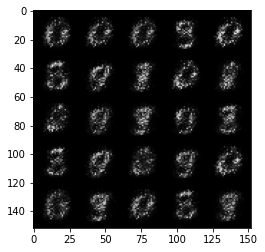

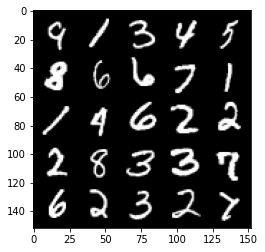

Step 3500: Generator loss: 2.3781, discriminator loss: 0.1329


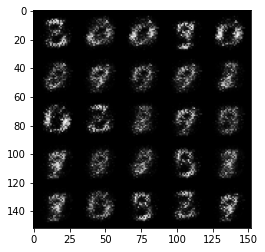

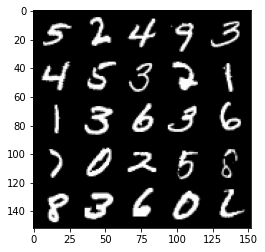

Step 4000: Generator loss: 2.7226, discriminator loss: 0.1144


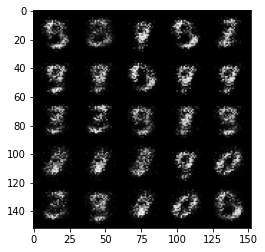

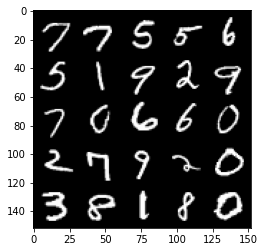

Step 4500: Generator loss: 3.1440, discriminator loss: 0.1015


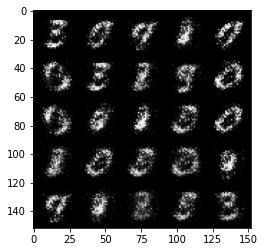

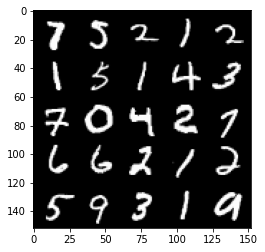

Step 5000: Generator loss: 3.4547, discriminator loss: 0.0839


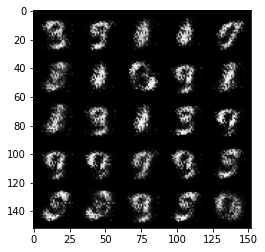

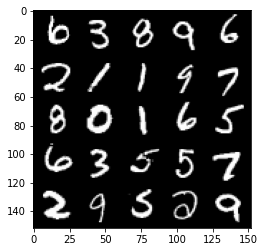

Step 5500: Generator loss: 3.5030, discriminator loss: 0.0862


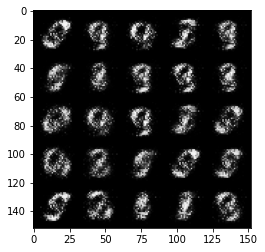

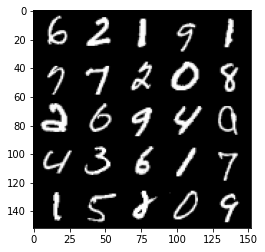

Step 6000: Generator loss: 3.7420, discriminator loss: 0.0757


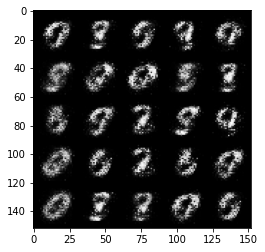

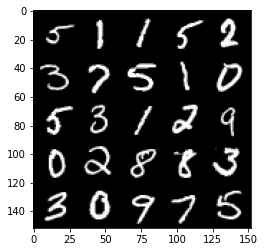

Step 6500: Generator loss: 3.8039, discriminator loss: 0.0625


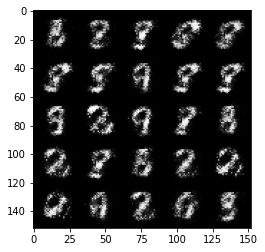

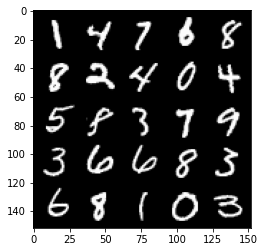

Step 7000: Generator loss: 3.9479, discriminator loss: 0.0601


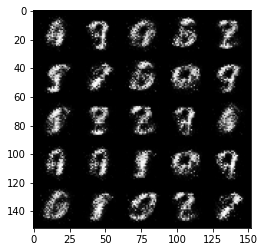

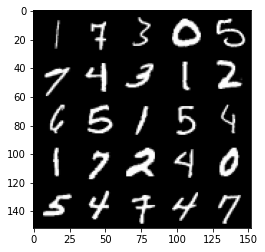

Step 7500: Generator loss: 4.1005, discriminator loss: 0.0480


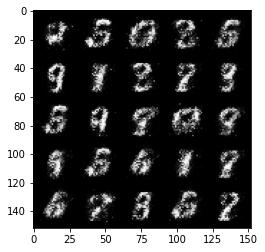

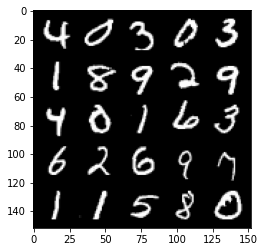

Step 8000: Generator loss: 4.1565, discriminator loss: 0.0556


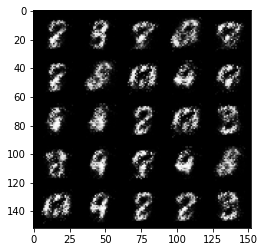

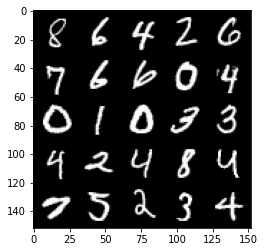

Step 8500: Generator loss: 4.0681, discriminator loss: 0.0691


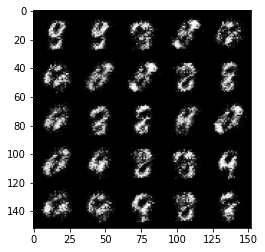

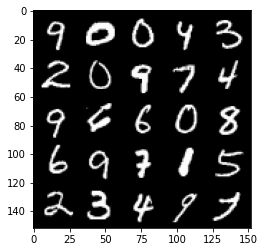

Step 9000: Generator loss: 4.0254, discriminator loss: 0.0707


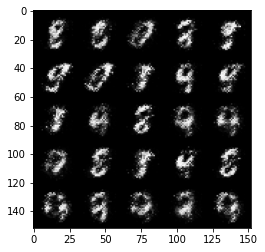

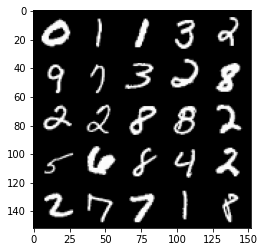

Step 9500: Generator loss: 3.9565, discriminator loss: 0.0634


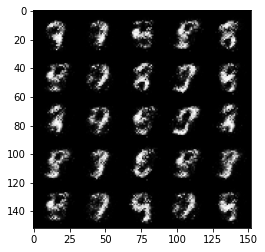

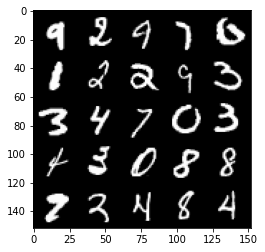

Step 10000: Generator loss: 4.0774, discriminator loss: 0.0631


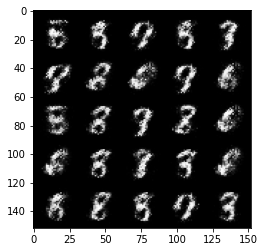

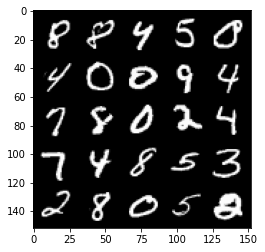

Step 10500: Generator loss: 4.0433, discriminator loss: 0.0679


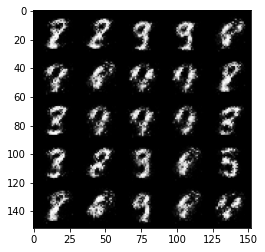

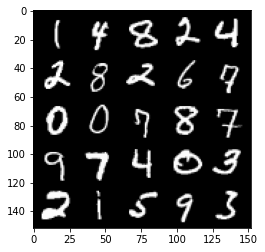

Step 11000: Generator loss: 4.0775, discriminator loss: 0.0614


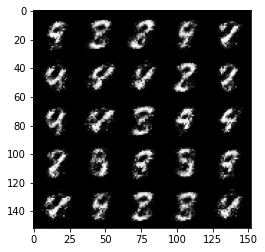

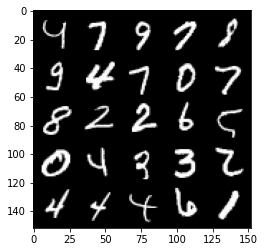

Step 11500: Generator loss: 3.8621, discriminator loss: 0.0705


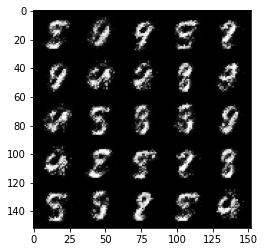

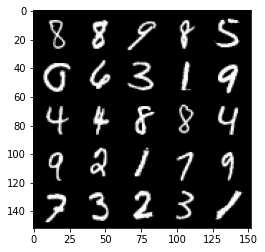

Step 12000: Generator loss: 4.0917, discriminator loss: 0.0736


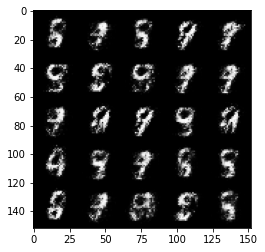

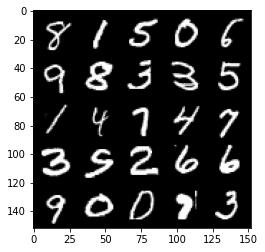

Step 12500: Generator loss: 3.8606, discriminator loss: 0.0841


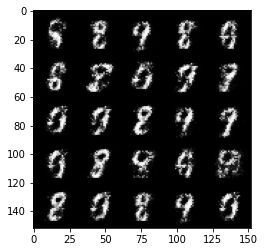

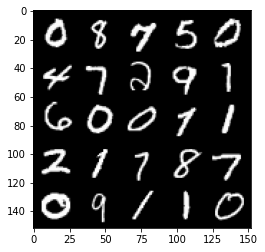

Step 13000: Generator loss: 3.7227, discriminator loss: 0.0838


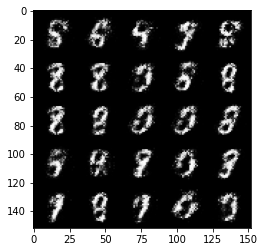

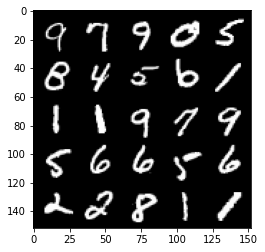

Step 13500: Generator loss: 3.8493, discriminator loss: 0.0843


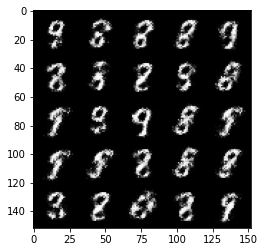

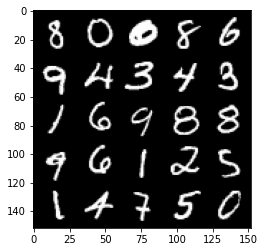

Step 14000: Generator loss: 3.8120, discriminator loss: 0.0906


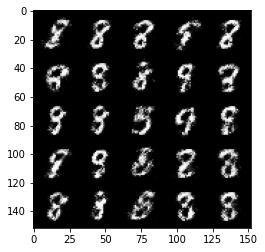

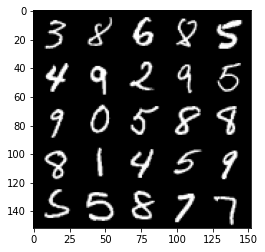

Step 14500: Generator loss: 3.7042, discriminator loss: 0.1023


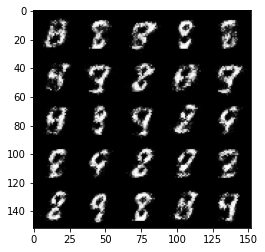

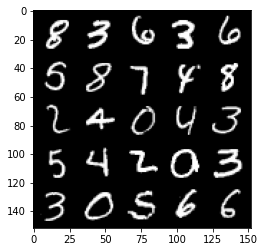

Step 15000: Generator loss: 3.6149, discriminator loss: 0.1084


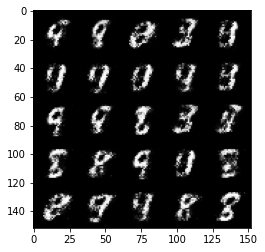

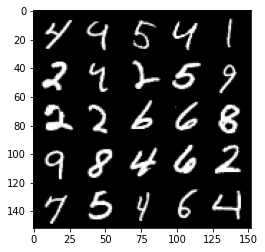

Step 15500: Generator loss: 3.6488, discriminator loss: 0.1034


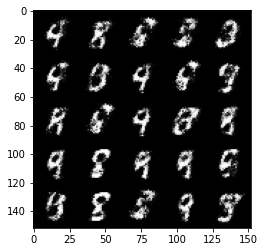

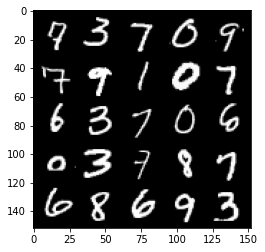

Step 16000: Generator loss: 3.5128, discriminator loss: 0.1052


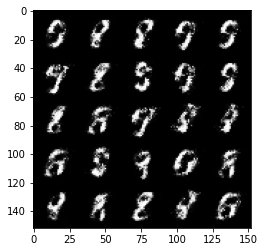

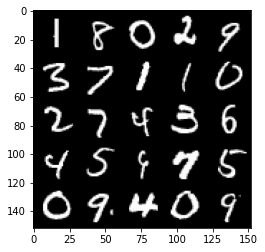

Step 16500: Generator loss: 3.6765, discriminator loss: 0.1128


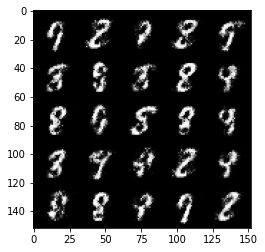

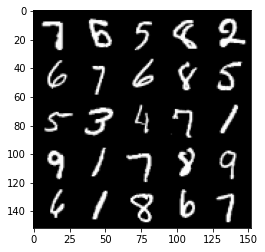

Step 17000: Generator loss: 3.5263, discriminator loss: 0.1158


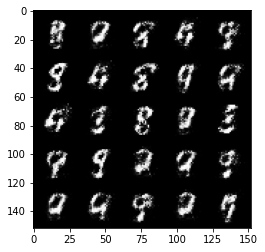

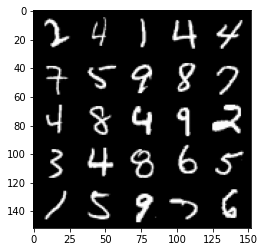

Step 17500: Generator loss: 3.5277, discriminator loss: 0.1201


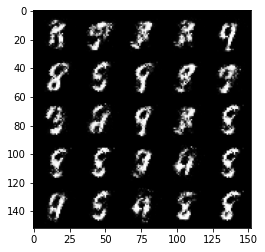

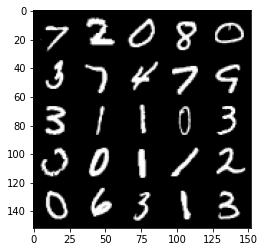

Step 18000: Generator loss: 3.6152, discriminator loss: 0.1167


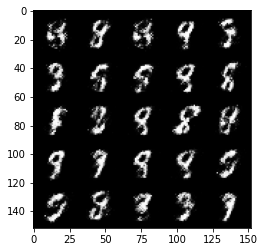

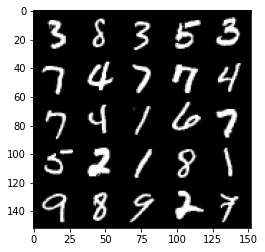

Step 18500: Generator loss: 3.5216, discriminator loss: 0.1345


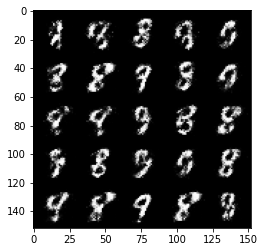

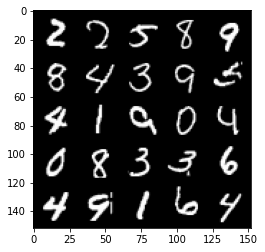

Step 19000: Generator loss: 3.6355, discriminator loss: 0.1103


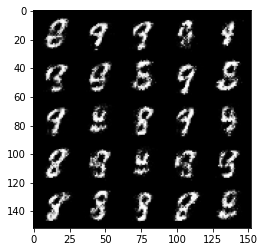

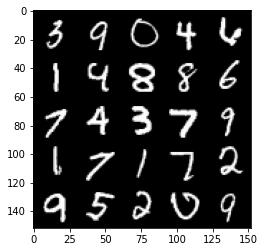

Step 19500: Generator loss: 3.4814, discriminator loss: 0.1236


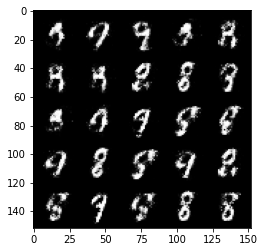

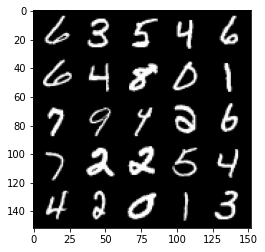

Step 20000: Generator loss: 3.4329, discriminator loss: 0.1237


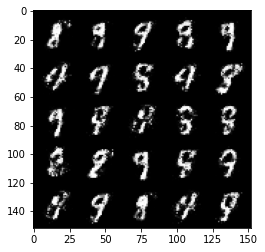

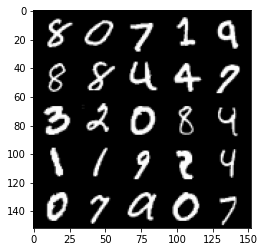

Step 20500: Generator loss: 3.2559, discriminator loss: 0.1436


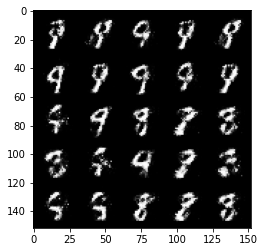

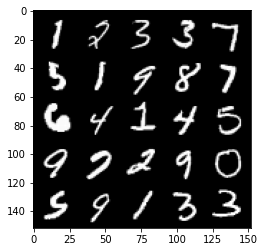

Step 21000: Generator loss: 3.2180, discriminator loss: 0.1473


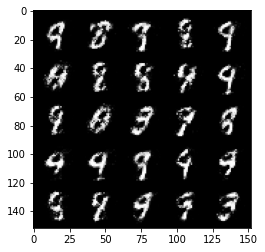

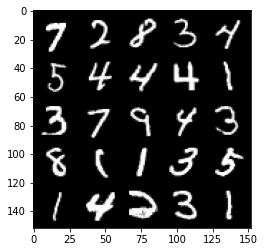

Step 21500: Generator loss: 3.2151, discriminator loss: 0.1478


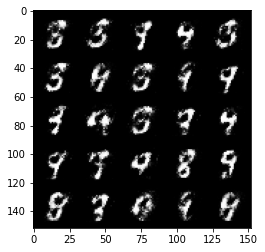

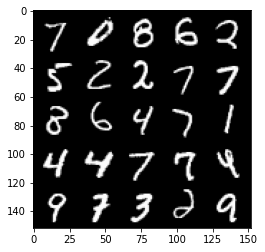

Step 22000: Generator loss: 3.1213, discriminator loss: 0.1677


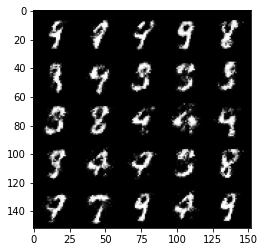

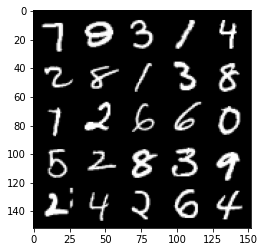

Step 22500: Generator loss: 3.0378, discriminator loss: 0.1831


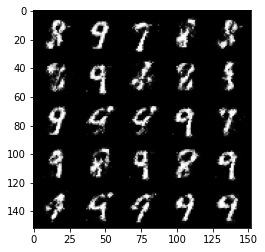

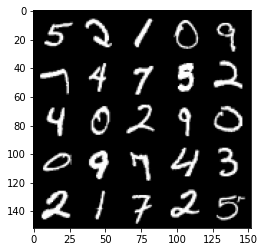

Step 23000: Generator loss: 3.0273, discriminator loss: 0.1713


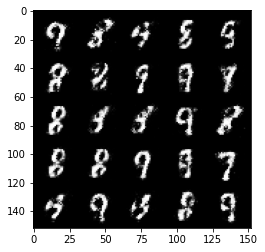

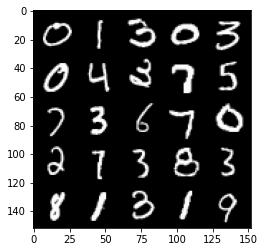

Step 23500: Generator loss: 3.0415, discriminator loss: 0.1687


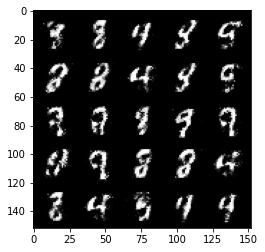

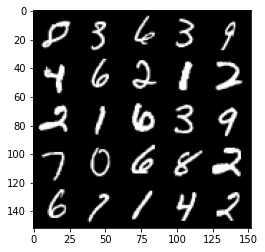

Step 24000: Generator loss: 3.0388, discriminator loss: 0.1721


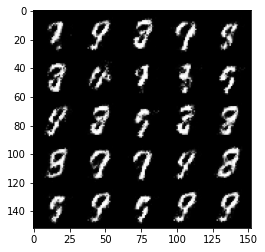

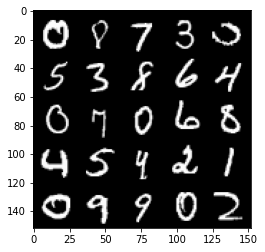

Step 24500: Generator loss: 3.0088, discriminator loss: 0.1719


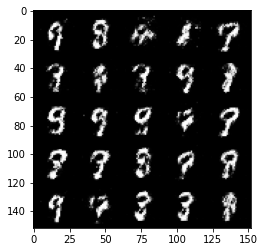

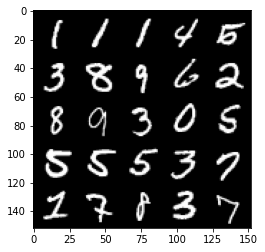

Step 25000: Generator loss: 2.9195, discriminator loss: 0.1996


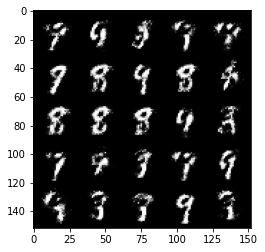

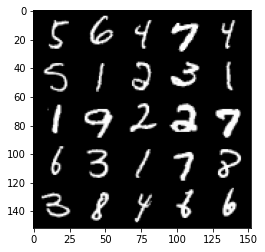

Step 25500: Generator loss: 2.7193, discriminator loss: 0.2201


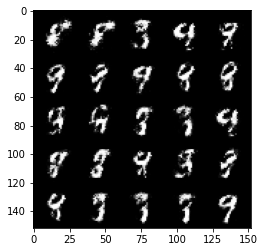

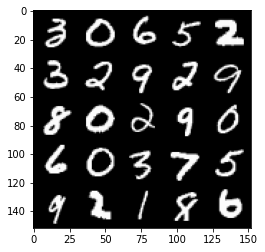

Step 26000: Generator loss: 2.8049, discriminator loss: 0.1941


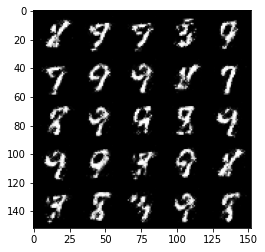

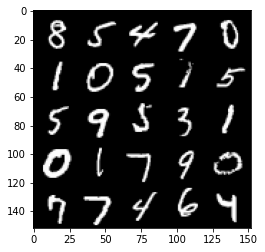

Step 26500: Generator loss: 2.9101, discriminator loss: 0.1825


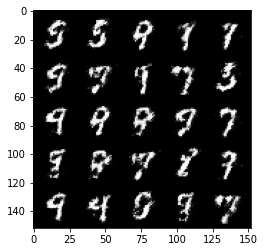

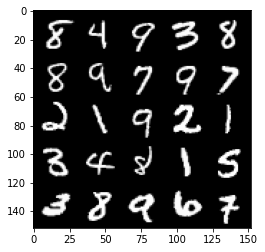

Step 27000: Generator loss: 2.7930, discriminator loss: 0.2035


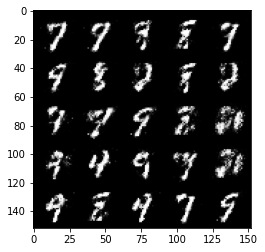

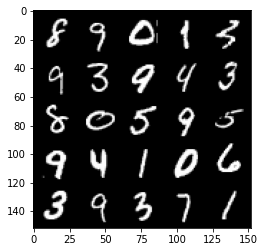

Step 27500: Generator loss: 2.7683, discriminator loss: 0.2206


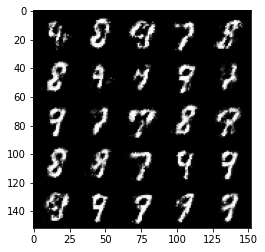

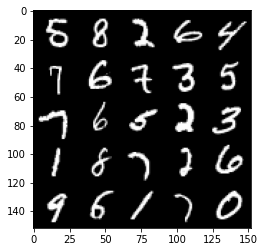

Step 28000: Generator loss: 2.6282, discriminator loss: 0.2295


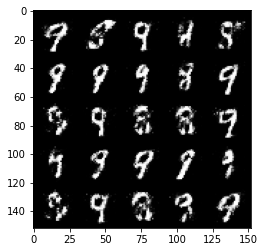

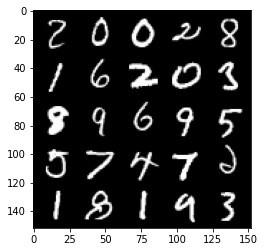

Step 28500: Generator loss: 2.7437, discriminator loss: 0.2099


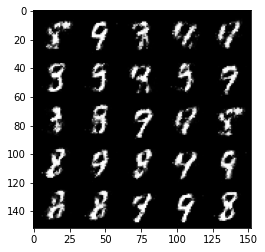

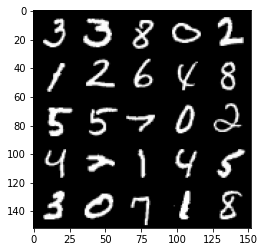

Step 29000: Generator loss: 2.6382, discriminator loss: 0.2330


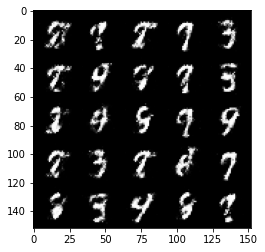

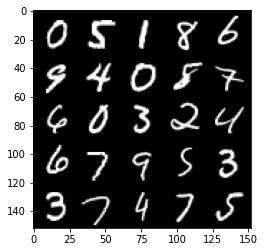

Step 29500: Generator loss: 2.7134, discriminator loss: 0.2062


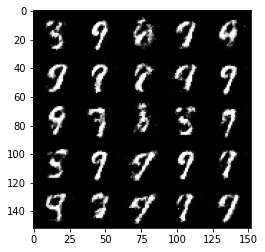

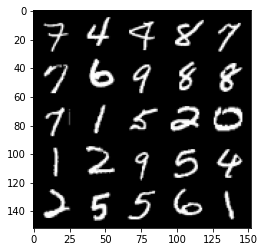

Step 30000: Generator loss: 2.8025, discriminator loss: 0.2121


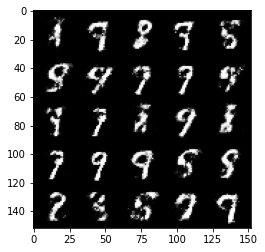

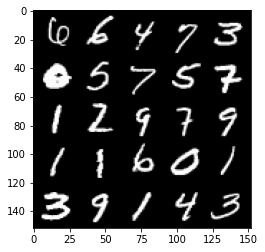

Step 30500: Generator loss: 2.7261, discriminator loss: 0.2236


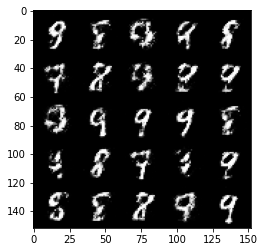

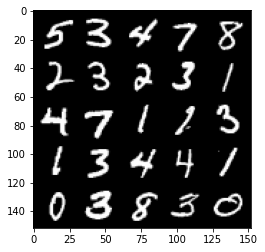

Step 31000: Generator loss: 2.7250, discriminator loss: 0.2203


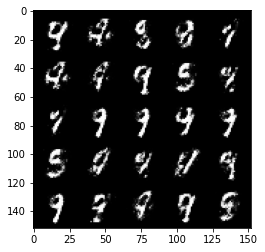

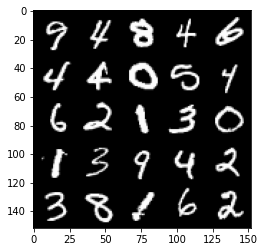

Step 31500: Generator loss: 2.6608, discriminator loss: 0.2368


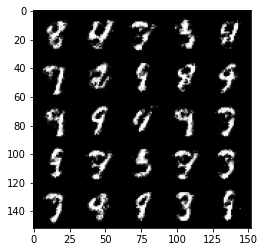

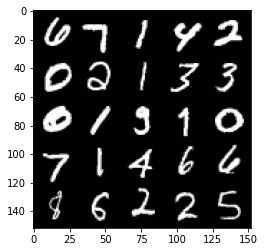

Step 32000: Generator loss: 2.7189, discriminator loss: 0.2144


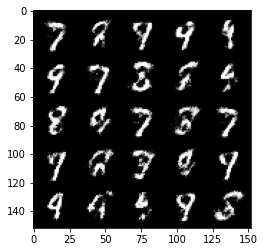

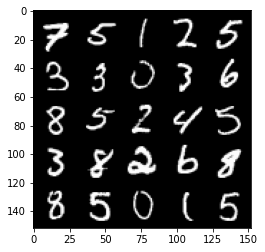

Step 32500: Generator loss: 2.7170, discriminator loss: 0.2164


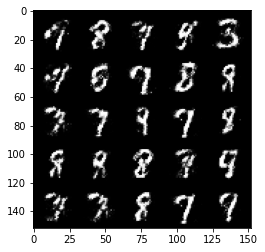

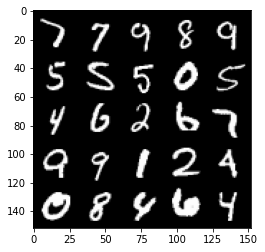

Step 33000: Generator loss: 2.5406, discriminator loss: 0.2474


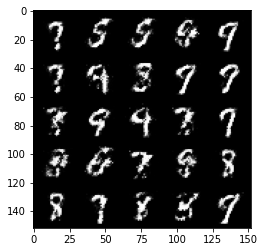

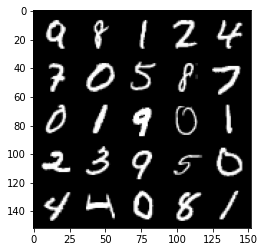

Step 33500: Generator loss: 2.4578, discriminator loss: 0.2523


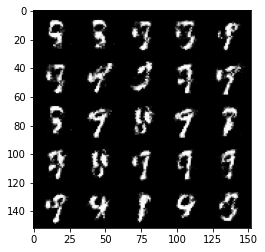

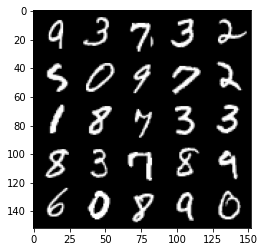

Step 34000: Generator loss: 2.4876, discriminator loss: 0.2373


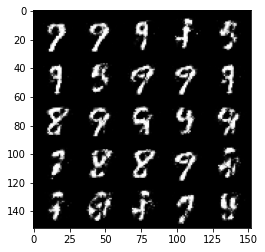

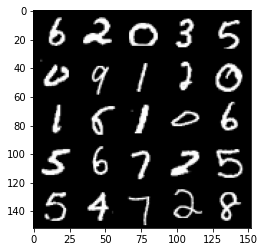

Step 34500: Generator loss: 2.5125, discriminator loss: 0.2333


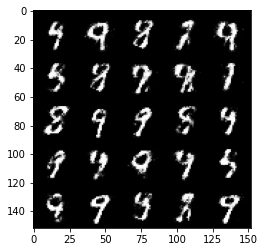

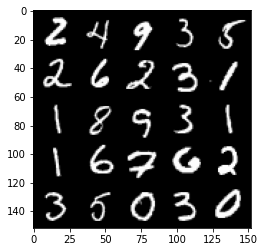

Step 35000: Generator loss: 2.4504, discriminator loss: 0.2434


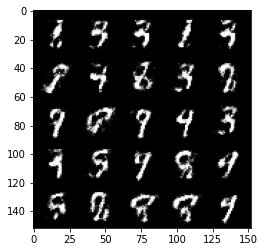

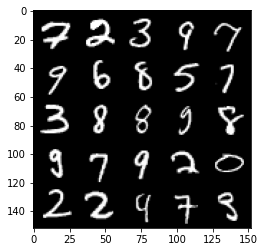

Step 35500: Generator loss: 2.4829, discriminator loss: 0.2434


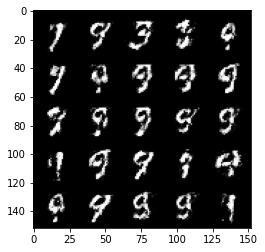

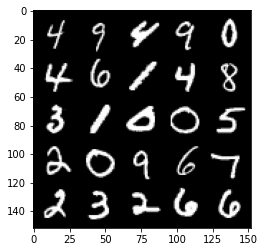

Step 36000: Generator loss: 2.3187, discriminator loss: 0.2733


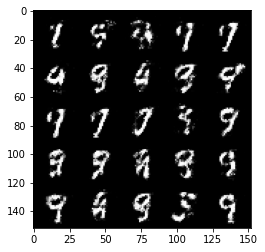

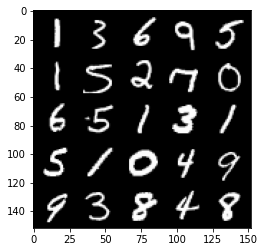

Step 36500: Generator loss: 2.4052, discriminator loss: 0.2527


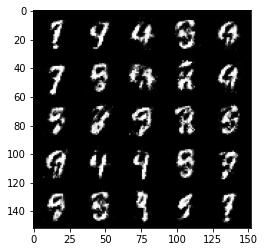

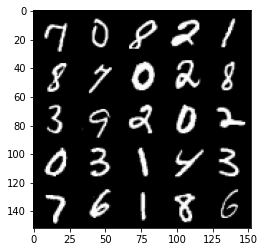

Step 37000: Generator loss: 2.3424, discriminator loss: 0.2738


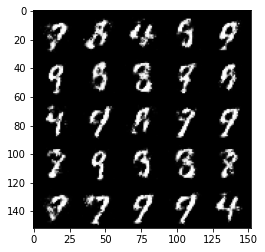

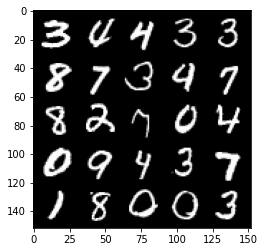

Step 37500: Generator loss: 2.3043, discriminator loss: 0.2854


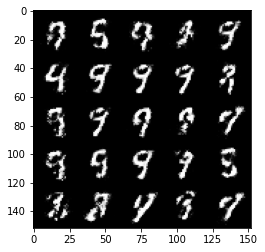

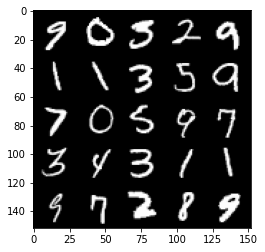

Step 38000: Generator loss: 2.3139, discriminator loss: 0.2744


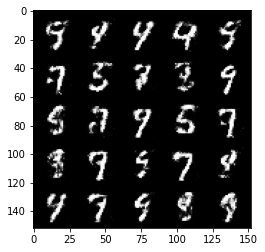

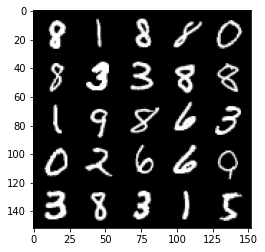

Step 38500: Generator loss: 2.2715, discriminator loss: 0.2893


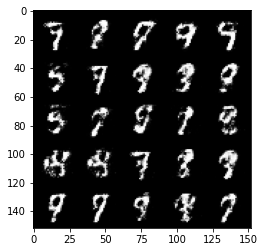

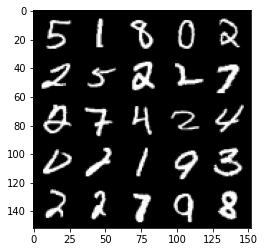

Step 39000: Generator loss: 2.1635, discriminator loss: 0.3045


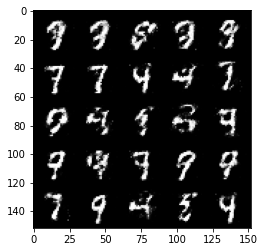

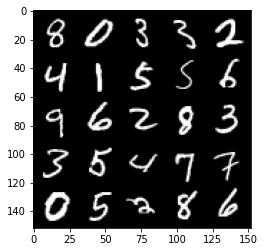

Step 39500: Generator loss: 2.0834, discriminator loss: 0.3202


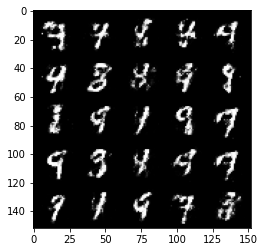

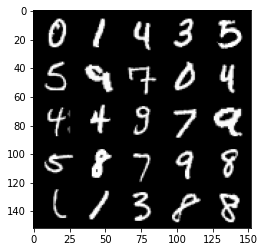

Step 40000: Generator loss: 2.1429, discriminator loss: 0.2982


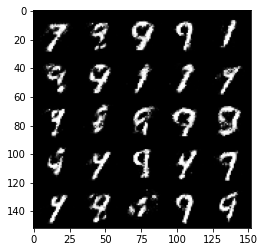

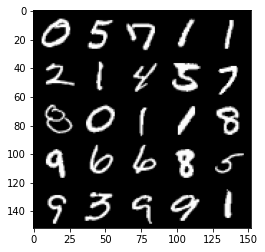

Step 40500: Generator loss: 2.1929, discriminator loss: 0.2735


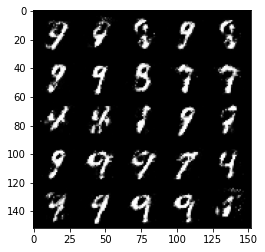

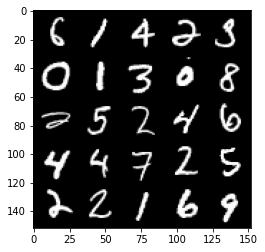

Step 41000: Generator loss: 2.2391, discriminator loss: 0.2673


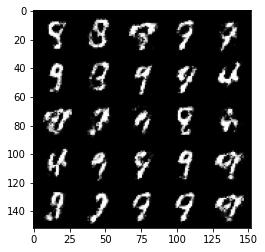

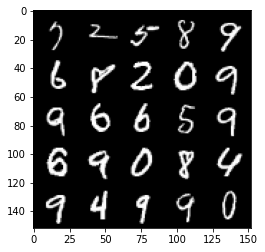

Step 41500: Generator loss: 2.1825, discriminator loss: 0.2830


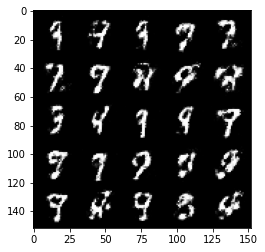

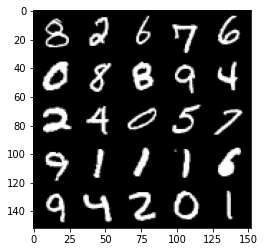

Step 42000: Generator loss: 2.0738, discriminator loss: 0.3125


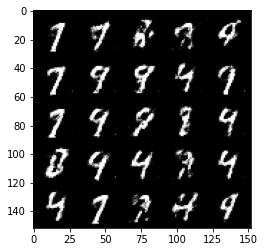

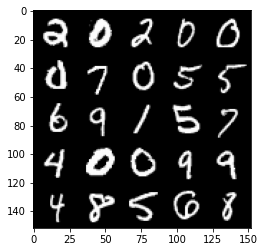

Step 42500: Generator loss: 2.0767, discriminator loss: 0.3072


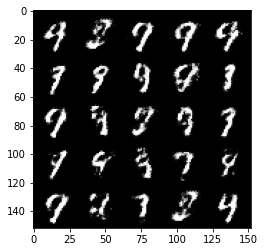

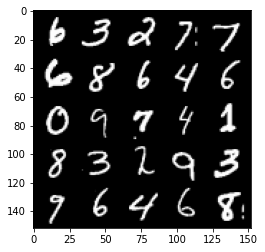

Step 43000: Generator loss: 2.0649, discriminator loss: 0.3170


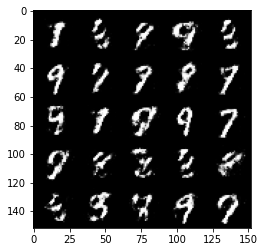

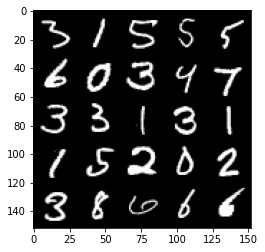

Step 43500: Generator loss: 2.1112, discriminator loss: 0.2952


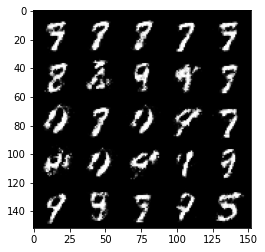

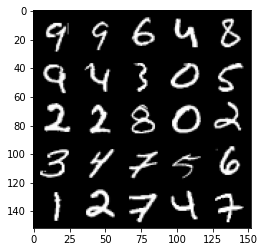

Step 44000: Generator loss: 2.0500, discriminator loss: 0.3094


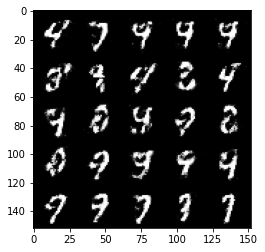

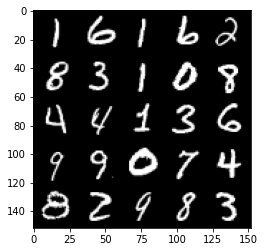

Step 44500: Generator loss: 2.0593, discriminator loss: 0.3016


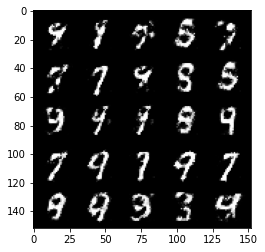

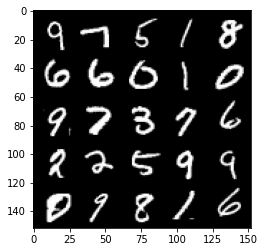

Step 45000: Generator loss: 2.0338, discriminator loss: 0.3051


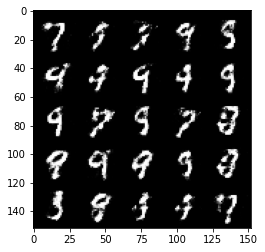

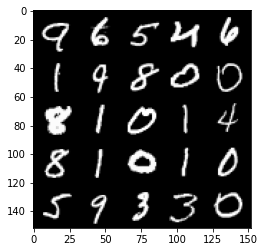

Step 45500: Generator loss: 2.0242, discriminator loss: 0.3173


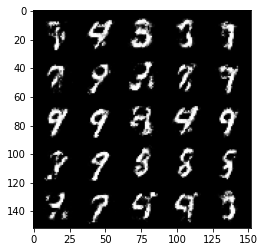

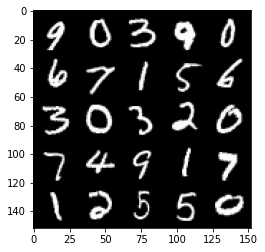

Step 46000: Generator loss: 1.9780, discriminator loss: 0.3315


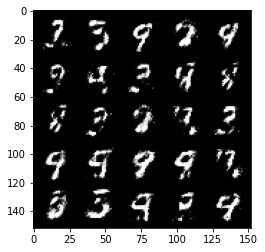

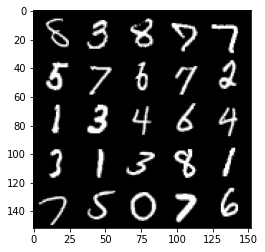

Step 46500: Generator loss: 2.1125, discriminator loss: 0.3068


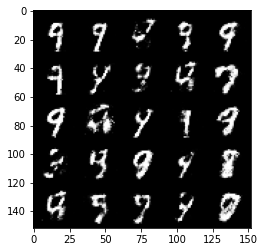

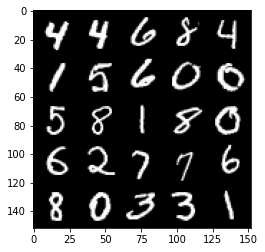

Step 47000: Generator loss: 1.9969, discriminator loss: 0.3133


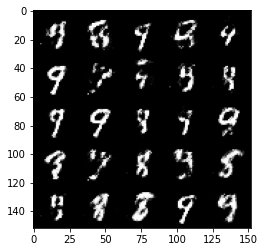

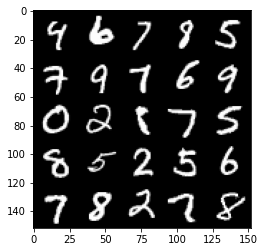

Step 47500: Generator loss: 2.1133, discriminator loss: 0.2966


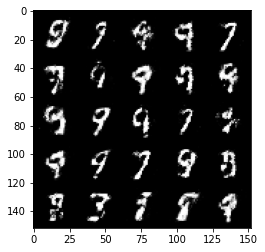

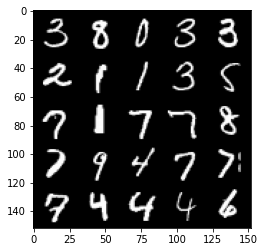

Step 48000: Generator loss: 1.9958, discriminator loss: 0.3236


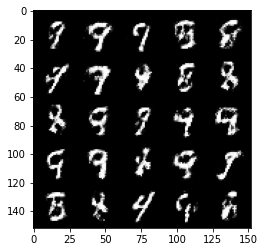

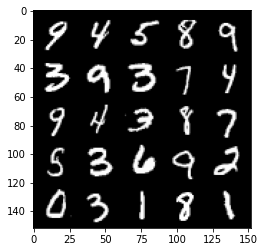

Step 48500: Generator loss: 1.9916, discriminator loss: 0.3187


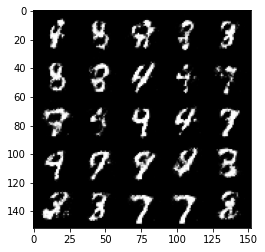

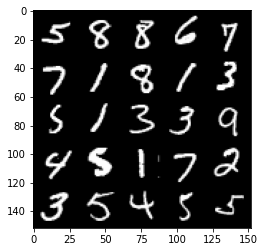

Step 49000: Generator loss: 1.9911, discriminator loss: 0.3279


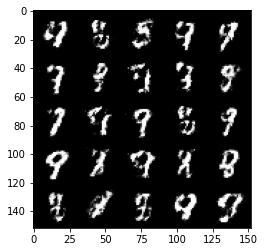

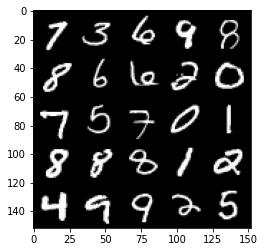

Step 49500: Generator loss: 2.0364, discriminator loss: 0.3134


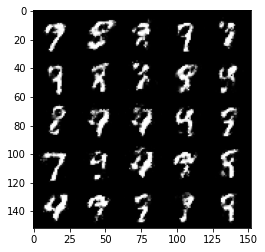

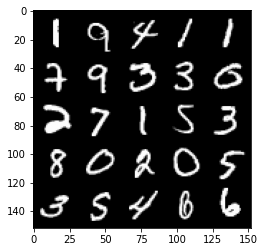

Step 50000: Generator loss: 2.0236, discriminator loss: 0.3195


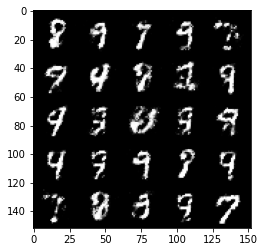

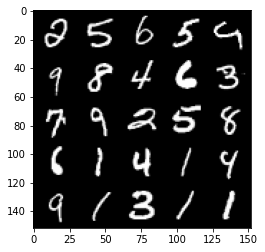

Step 50500: Generator loss: 1.9265, discriminator loss: 0.3316


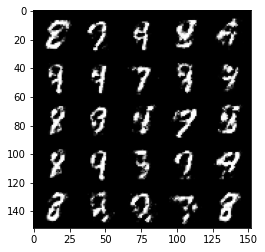

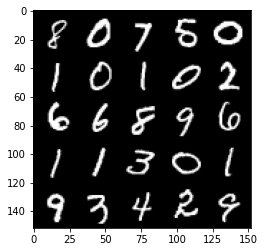

Step 51000: Generator loss: 1.9701, discriminator loss: 0.3347


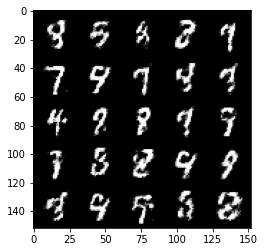

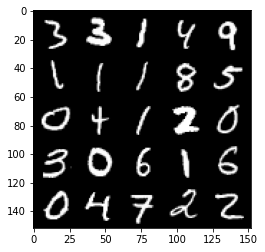

Step 51500: Generator loss: 1.8868, discriminator loss: 0.3477


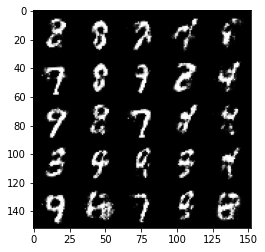

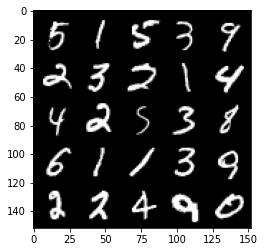

Step 52000: Generator loss: 1.8434, discriminator loss: 0.3429


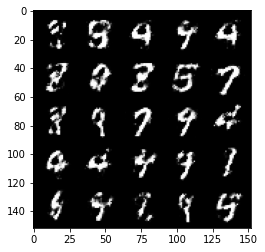

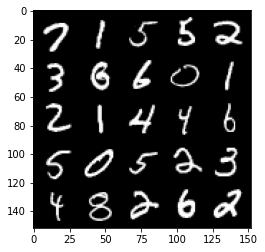

Step 52500: Generator loss: 1.9394, discriminator loss: 0.3252


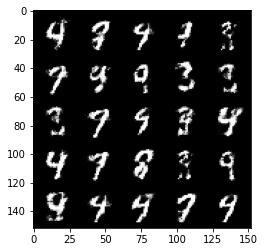

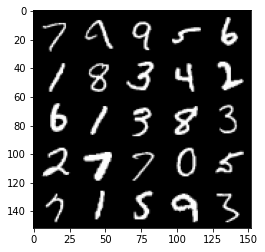

Step 53000: Generator loss: 1.9119, discriminator loss: 0.3311


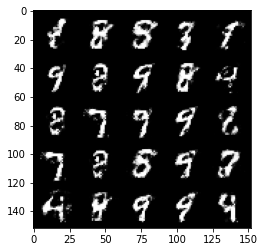

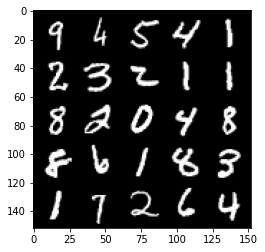

Step 53500: Generator loss: 1.8208, discriminator loss: 0.3462


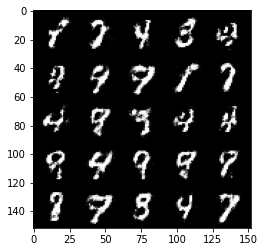

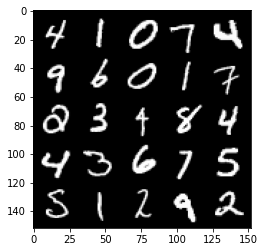

Step 54000: Generator loss: 1.9142, discriminator loss: 0.3284


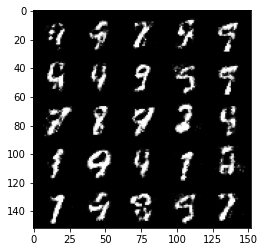

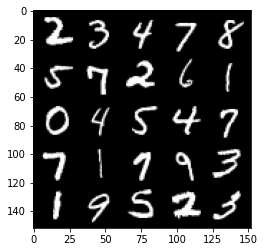

Step 54500: Generator loss: 1.8242, discriminator loss: 0.3465


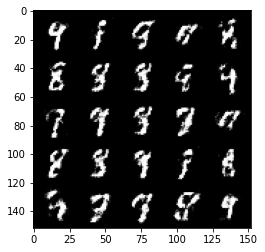

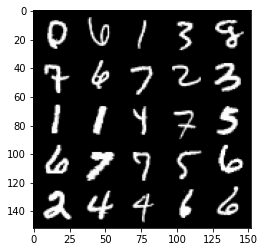

Step 55000: Generator loss: 1.7906, discriminator loss: 0.3697


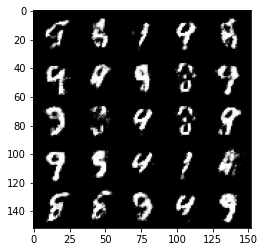

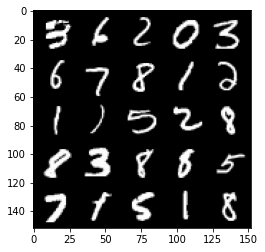

Step 55500: Generator loss: 1.8499, discriminator loss: 0.3384


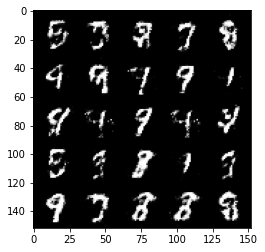

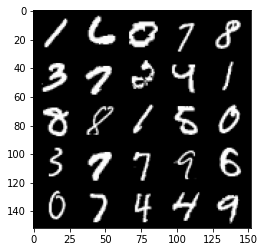

Step 56000: Generator loss: 1.8278, discriminator loss: 0.3609


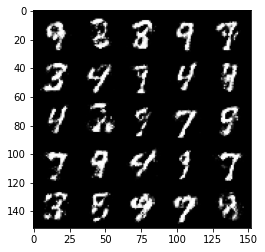

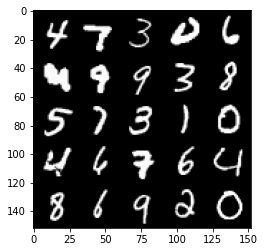

Step 56500: Generator loss: 1.7723, discriminator loss: 0.3764


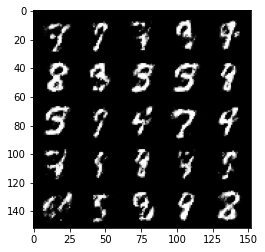

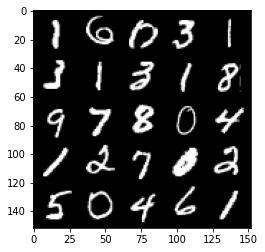

Step 57000: Generator loss: 1.7925, discriminator loss: 0.3496


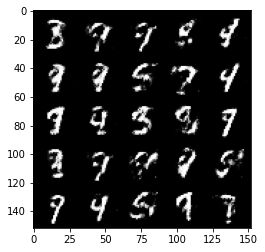

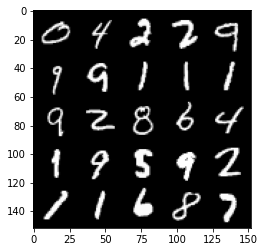

Step 57500: Generator loss: 1.7765, discriminator loss: 0.3691


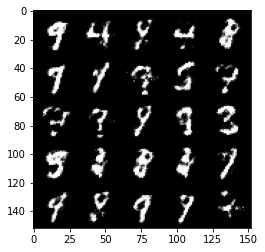

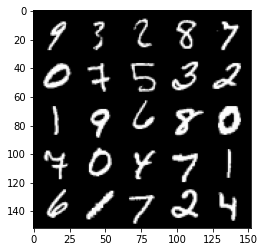

Step 58000: Generator loss: 1.7305, discriminator loss: 0.3876


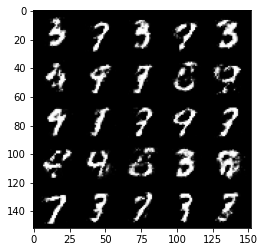

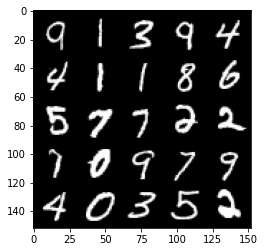

Step 58500: Generator loss: 1.7557, discriminator loss: 0.3605


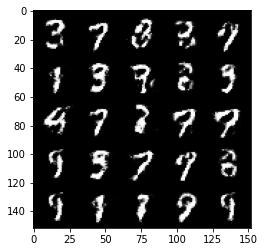

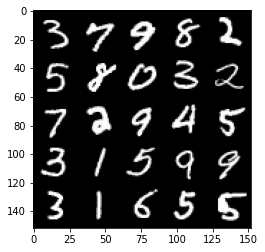

Step 59000: Generator loss: 1.7642, discriminator loss: 0.3664


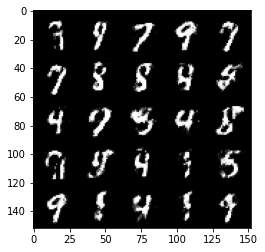

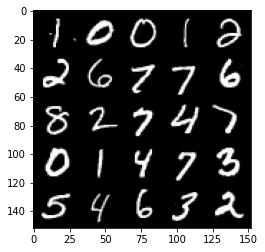

Step 59500: Generator loss: 1.7265, discriminator loss: 0.3828


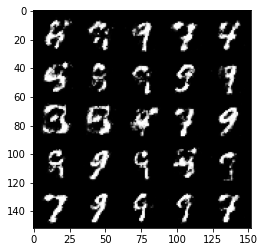

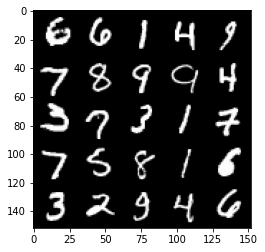

Step 60000: Generator loss: 1.6645, discriminator loss: 0.3961


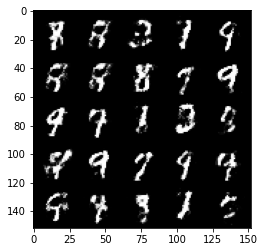

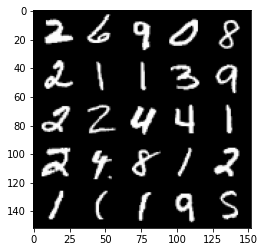

Step 60500: Generator loss: 1.6714, discriminator loss: 0.3832


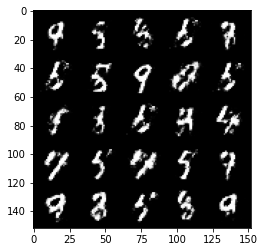

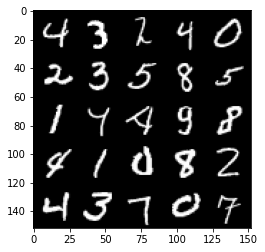

Step 61000: Generator loss: 1.7600, discriminator loss: 0.3661


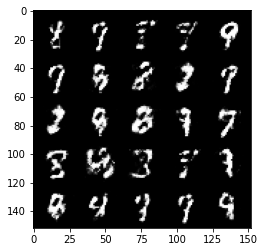

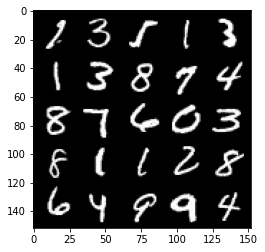

Step 61500: Generator loss: 1.7616, discriminator loss: 0.3588


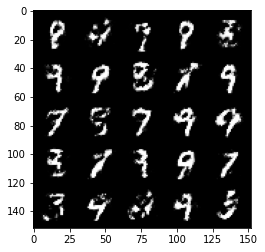

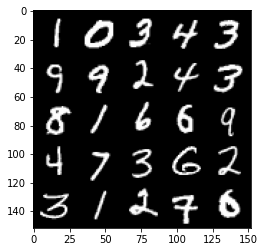

Step 62000: Generator loss: 1.6491, discriminator loss: 0.3989


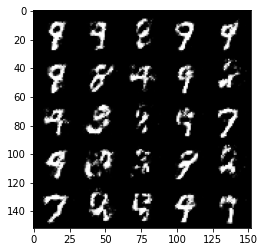

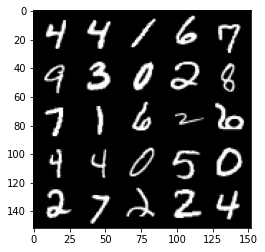

Step 62500: Generator loss: 1.6939, discriminator loss: 0.3794


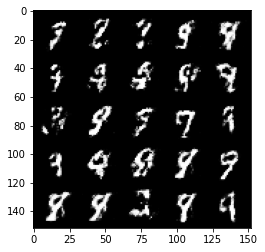

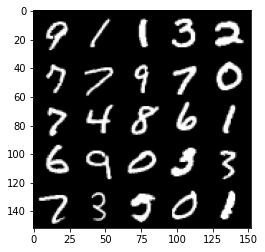

Step 63000: Generator loss: 1.6561, discriminator loss: 0.3880


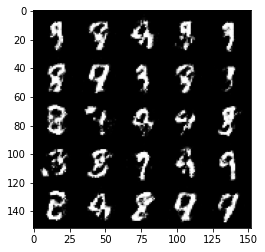

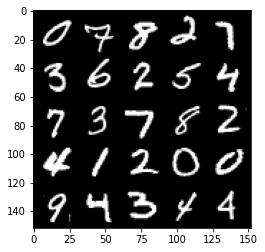

Step 63500: Generator loss: 1.6422, discriminator loss: 0.3886


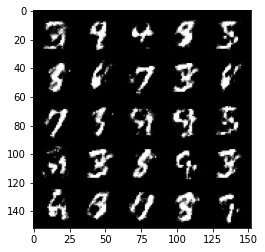

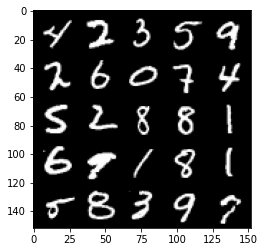

Step 64000: Generator loss: 1.7252, discriminator loss: 0.3686


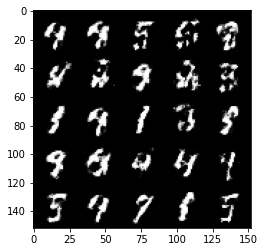

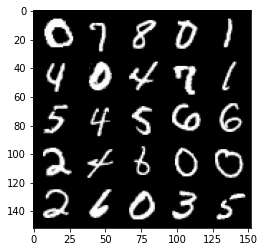

Step 64500: Generator loss: 1.6801, discriminator loss: 0.3867


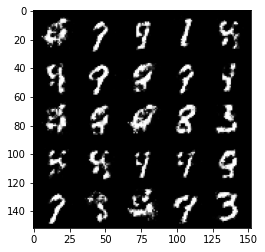

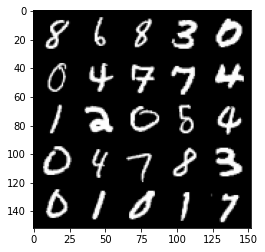

Step 65000: Generator loss: 1.6242, discriminator loss: 0.3993


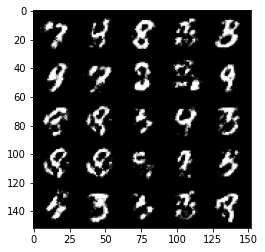

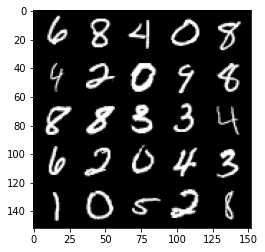

Step 65500: Generator loss: 1.6267, discriminator loss: 0.4000


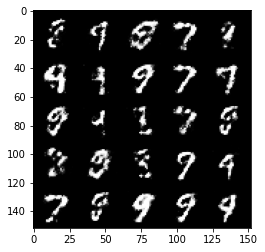

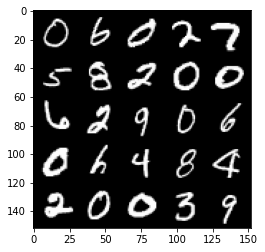

Step 66000: Generator loss: 1.5529, discriminator loss: 0.4145


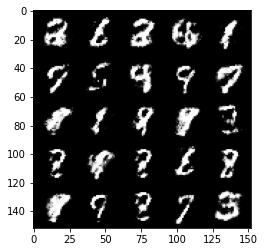

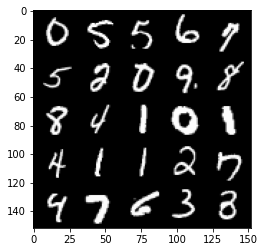

Step 66500: Generator loss: 1.5590, discriminator loss: 0.4107


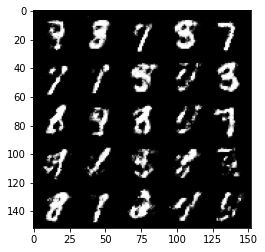

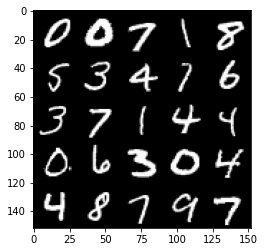

Step 67000: Generator loss: 1.6032, discriminator loss: 0.4022


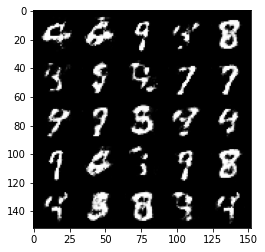

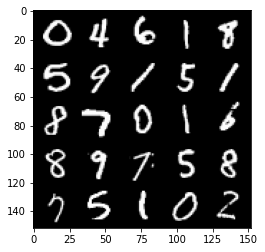

Step 67500: Generator loss: 1.5025, discriminator loss: 0.4280


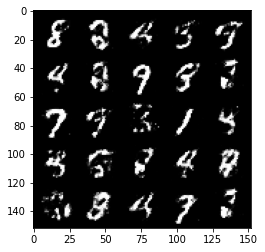

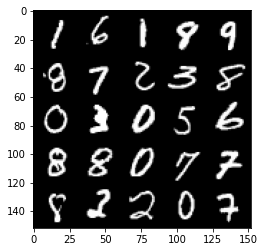

Step 68000: Generator loss: 1.5437, discriminator loss: 0.4031


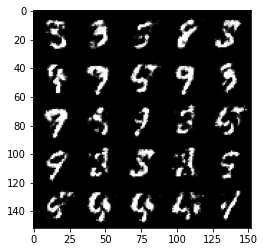

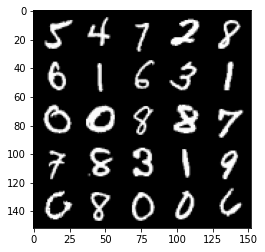

Step 68500: Generator loss: 1.5886, discriminator loss: 0.4016


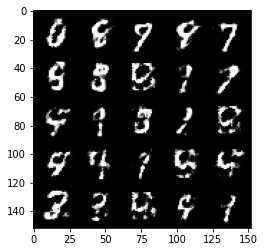

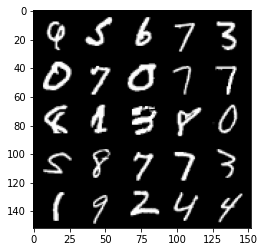

Step 69000: Generator loss: 1.5193, discriminator loss: 0.4273


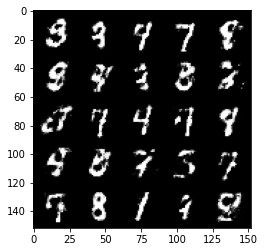

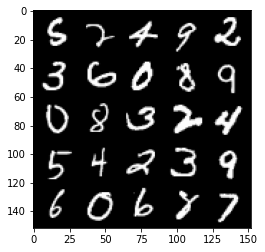

Step 69500: Generator loss: 1.5746, discriminator loss: 0.4053


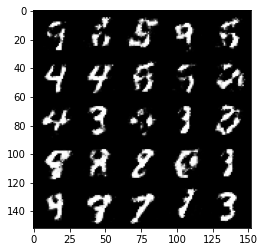

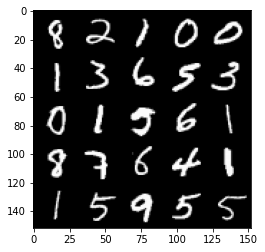

Step 70000: Generator loss: 1.5971, discriminator loss: 0.3994


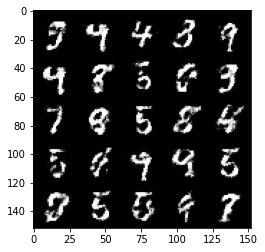

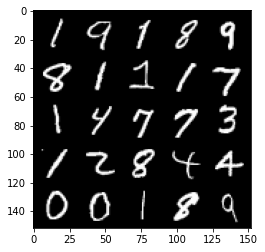

Step 70500: Generator loss: 1.5452, discriminator loss: 0.4138


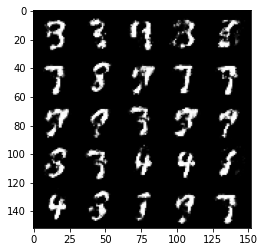

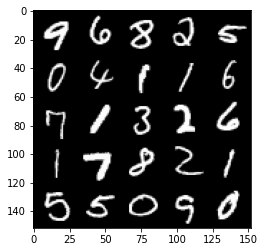

Step 71000: Generator loss: 1.6346, discriminator loss: 0.3844


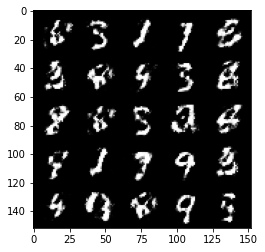

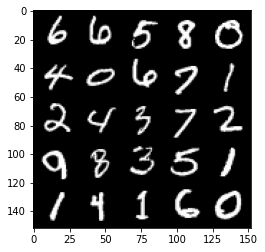

Step 71500: Generator loss: 1.6176, discriminator loss: 0.3899


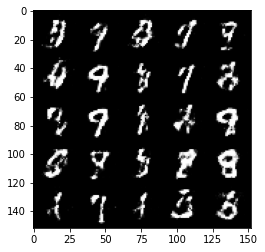

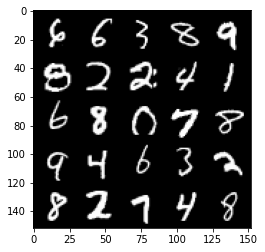

Step 72000: Generator loss: 1.5559, discriminator loss: 0.4025


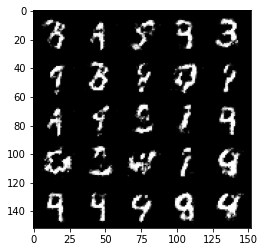

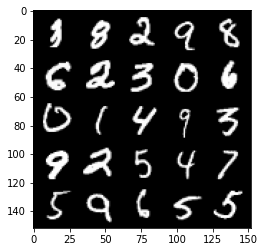

Step 72500: Generator loss: 1.6281, discriminator loss: 0.3845


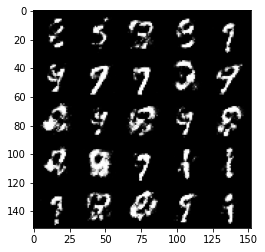

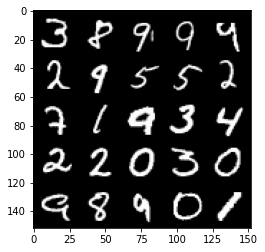

Step 73000: Generator loss: 1.5148, discriminator loss: 0.4339


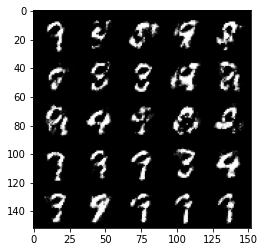

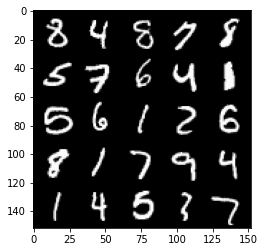

Step 73500: Generator loss: 1.3630, discriminator loss: 0.4811


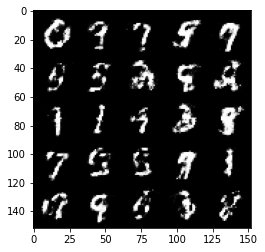

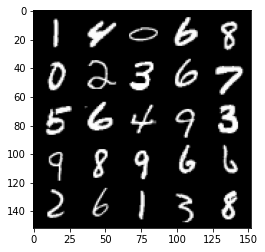

Step 74000: Generator loss: 1.3831, discriminator loss: 0.4651


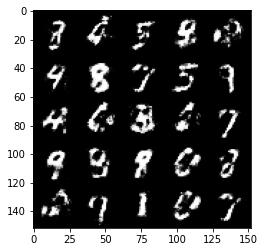

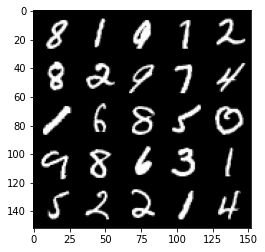

Step 74500: Generator loss: 1.4014, discriminator loss: 0.4527


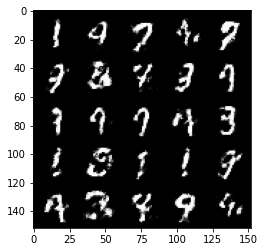

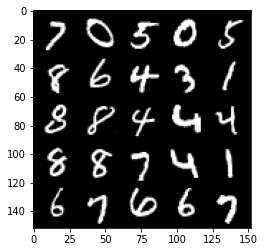

Step 75000: Generator loss: 1.4706, discriminator loss: 0.4288


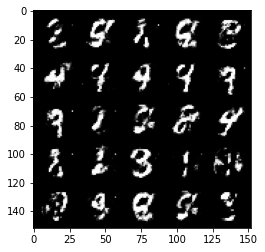

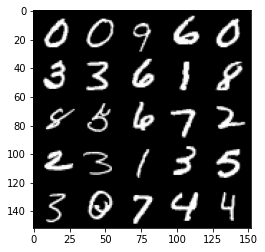

Step 75500: Generator loss: 1.4576, discriminator loss: 0.4292


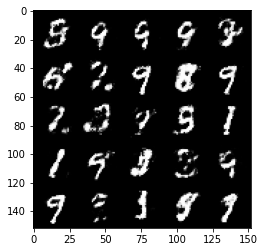

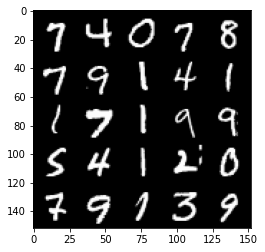

Step 76000: Generator loss: 1.4580, discriminator loss: 0.4361


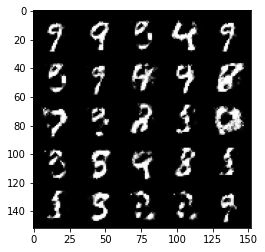

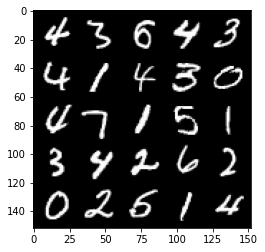

Step 76500: Generator loss: 1.4801, discriminator loss: 0.4290


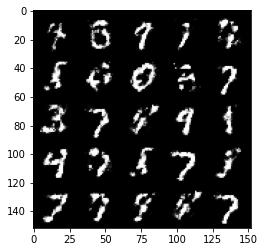

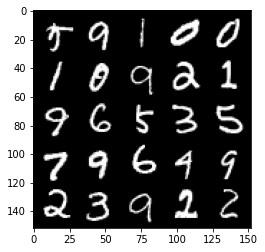

Step 77000: Generator loss: 1.4402, discriminator loss: 0.4320


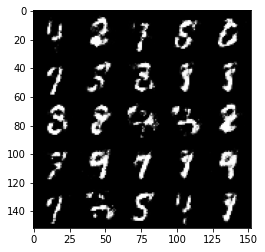

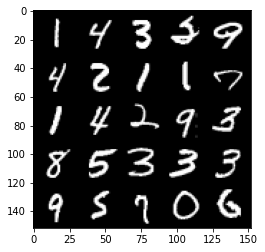

Step 77500: Generator loss: 1.5504, discriminator loss: 0.3922


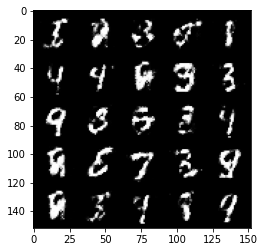

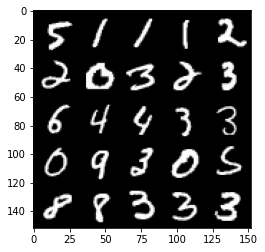

Step 78000: Generator loss: 1.5180, discriminator loss: 0.4132


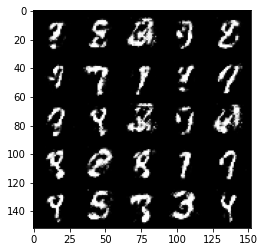

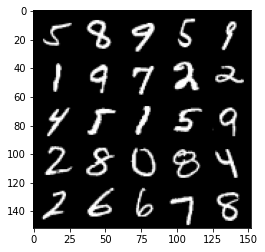

Step 78500: Generator loss: 1.4955, discriminator loss: 0.4133


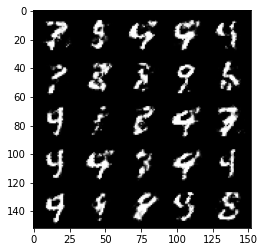

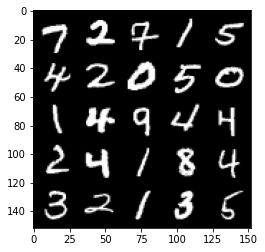

Step 79000: Generator loss: 1.5299, discriminator loss: 0.4146


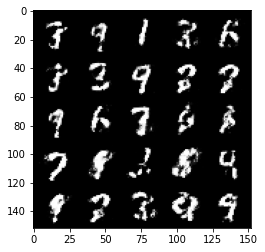

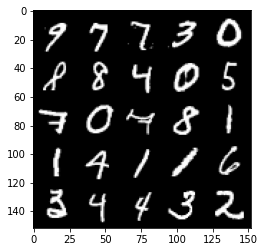

Step 79500: Generator loss: 1.4755, discriminator loss: 0.4346


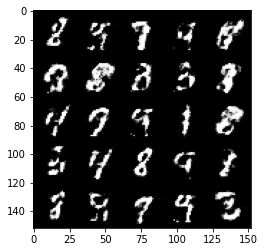

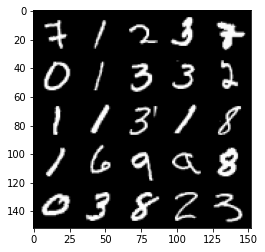

Step 80000: Generator loss: 1.4329, discriminator loss: 0.4427


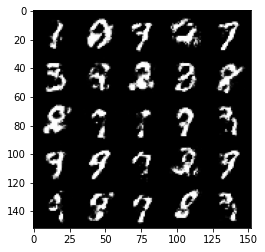

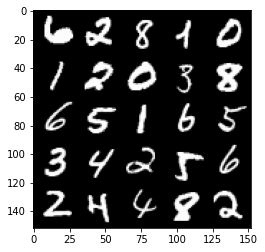

Step 80500: Generator loss: 1.4556, discriminator loss: 0.4292


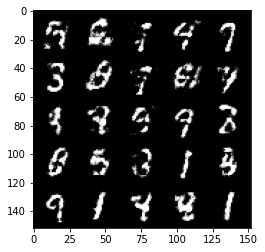

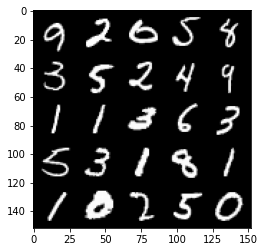

Step 81000: Generator loss: 1.3952, discriminator loss: 0.4550


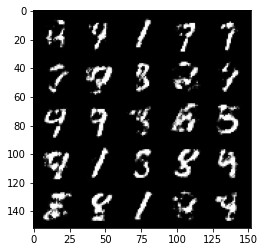

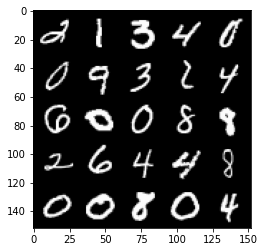

Step 81500: Generator loss: 1.3409, discriminator loss: 0.4688


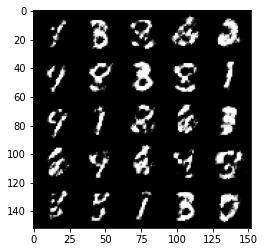

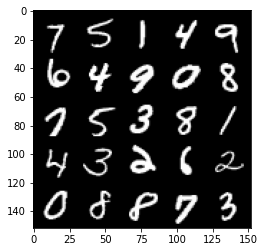

Step 82000: Generator loss: 1.3315, discriminator loss: 0.4674


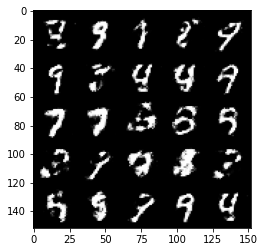

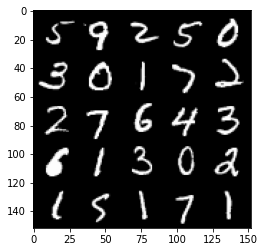

Step 82500: Generator loss: 1.3583, discriminator loss: 0.4614


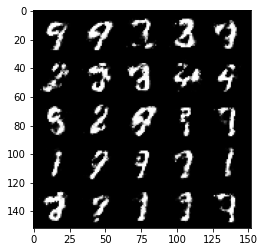

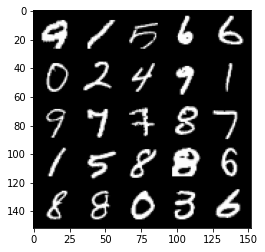

Step 83000: Generator loss: 1.4030, discriminator loss: 0.4411


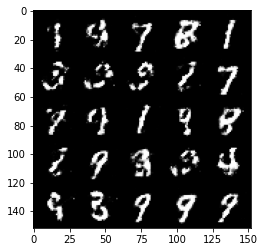

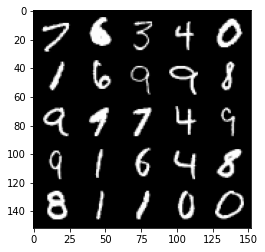

Step 83500: Generator loss: 1.3851, discriminator loss: 0.4522


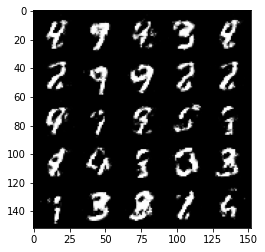

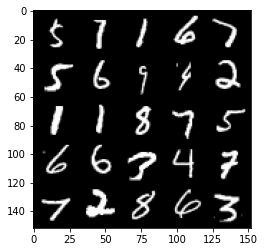

Step 84000: Generator loss: 1.3284, discriminator loss: 0.4638


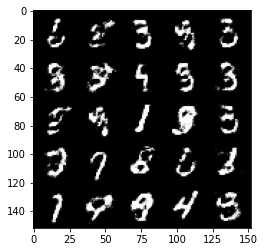

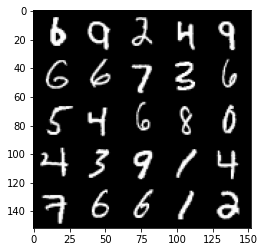

Step 84500: Generator loss: 1.3195, discriminator loss: 0.4706


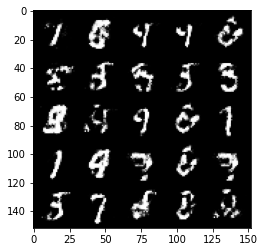

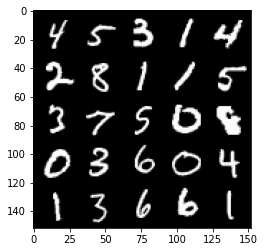

Step 85000: Generator loss: 1.2432, discriminator loss: 0.4934


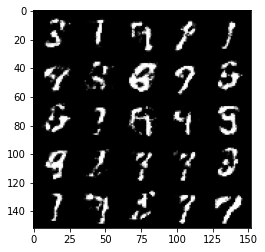

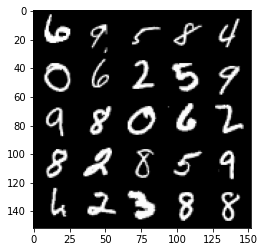

Step 85500: Generator loss: 1.3259, discriminator loss: 0.4627


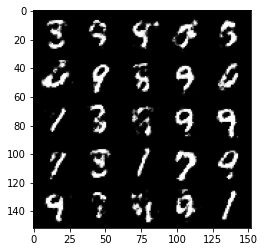

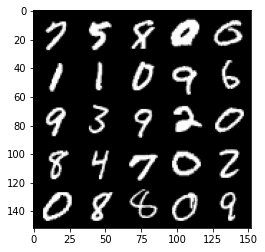

Step 86000: Generator loss: 1.2805, discriminator loss: 0.4742


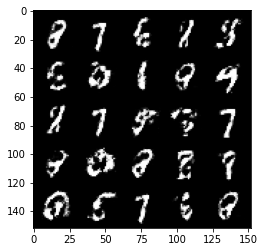

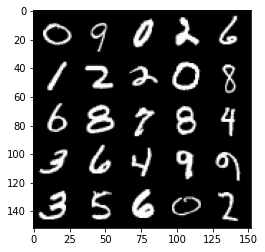

Step 86500: Generator loss: 1.3118, discriminator loss: 0.4770


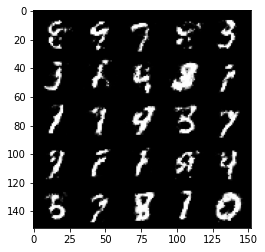

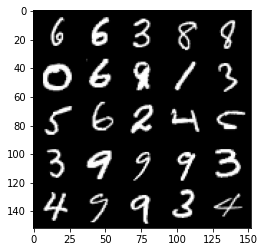

Step 87000: Generator loss: 1.2883, discriminator loss: 0.4776


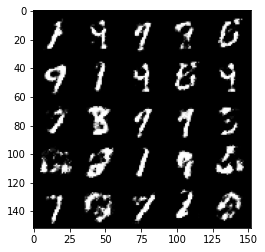

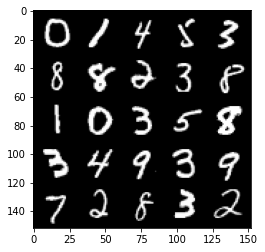

Step 87500: Generator loss: 1.2224, discriminator loss: 0.5031


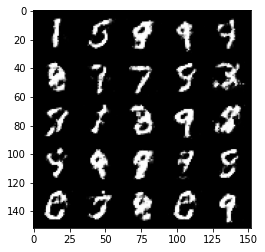

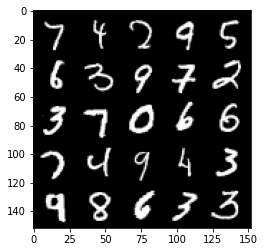

Step 88000: Generator loss: 1.2250, discriminator loss: 0.5077


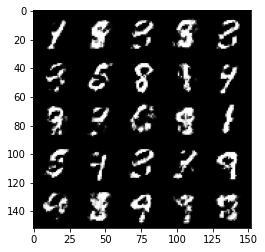

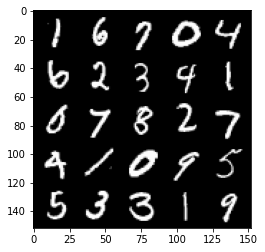

Step 88500: Generator loss: 1.2809, discriminator loss: 0.4833


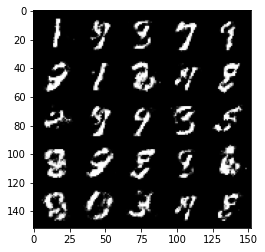

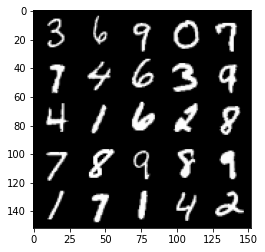

Step 89000: Generator loss: 1.2596, discriminator loss: 0.4949


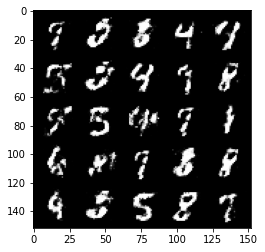

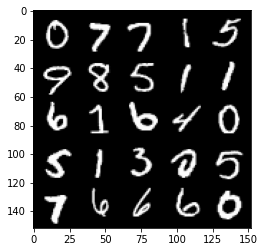

Step 89500: Generator loss: 1.3049, discriminator loss: 0.4806


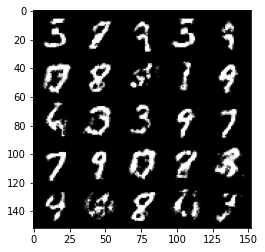

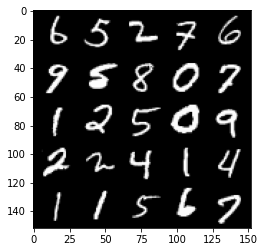

Step 90000: Generator loss: 1.2277, discriminator loss: 0.5098


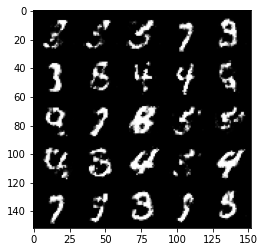

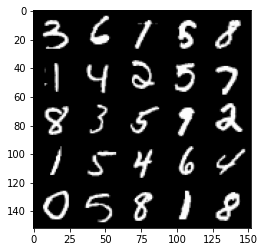

Step 90500: Generator loss: 1.2371, discriminator loss: 0.4874


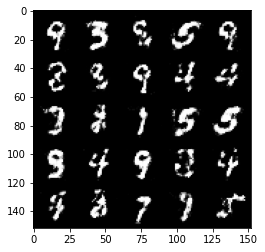

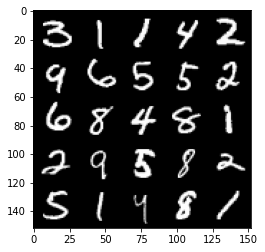

Step 91000: Generator loss: 1.2878, discriminator loss: 0.4883


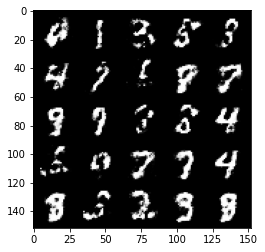

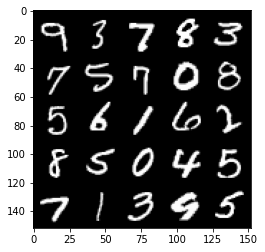

Step 91500: Generator loss: 1.2608, discriminator loss: 0.4904


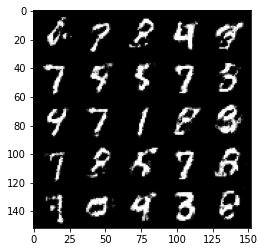

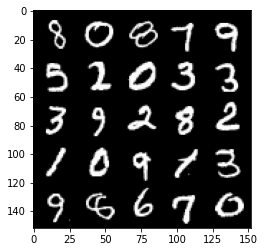

Step 92000: Generator loss: 1.2043, discriminator loss: 0.5139


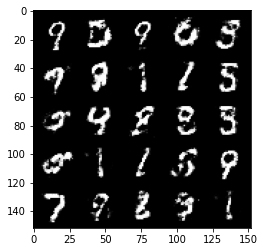

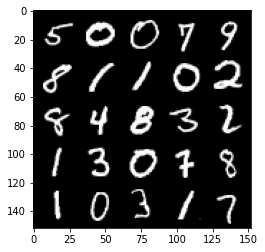

Step 92500: Generator loss: 1.2966, discriminator loss: 0.4724


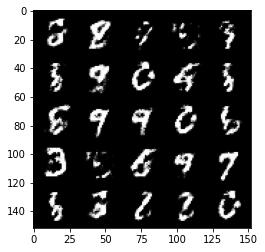

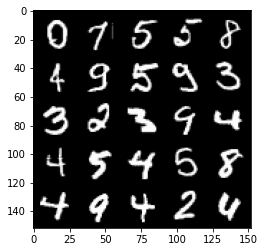

Step 93000: Generator loss: 1.2560, discriminator loss: 0.4802


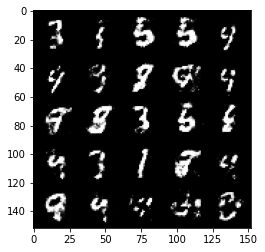

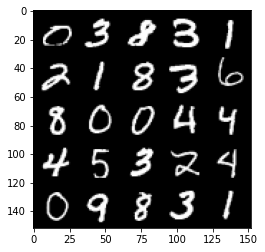

Step 93500: Generator loss: 1.2560, discriminator loss: 0.4914


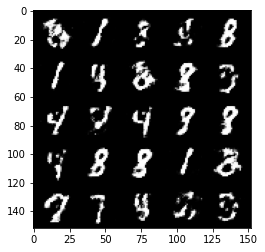

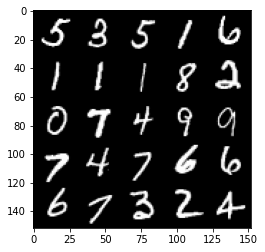

In [ ]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
# gen_loss = False
for epoch in tqdm(range(n_epochs)):
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device) # Flatten the batch of real images from the dataset

        ### Update discriminator ###
        disc_opt.zero_grad()
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        disc_loss.backward(retain_graph=True)
        disc_opt.step()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss:.4f}, discriminator loss: {mean_discriminator_loss:.4f}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1


In [ ]:
!nvidia-smi

Wed Nov  3 06:45:10 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    58W / 149W |    569MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## DCGAN

*Note: [here](https://arxiv.org/pdf/1511.06434v1.pdf) is the paper if you are interested! It might look dense now, but soon you'll be able to understand many parts of it :)*

Ниже предтавлены основные особенности и советы по обучению стабильных DCGAN. Эти рекомендации взяты из статьи:

* Replace any pooling layers with strided convolutions (discriminator) and fractional-strided
convolutions (generator).
* Use BatchNorm in both the generator and the discriminator.
* Remove fully connected hidden layers for deeper architectures.
* Use ReLU activation in generator for all layers except for the output, which uses Tanh.
* Use LeakyReLU activation in the discriminator for all layers.

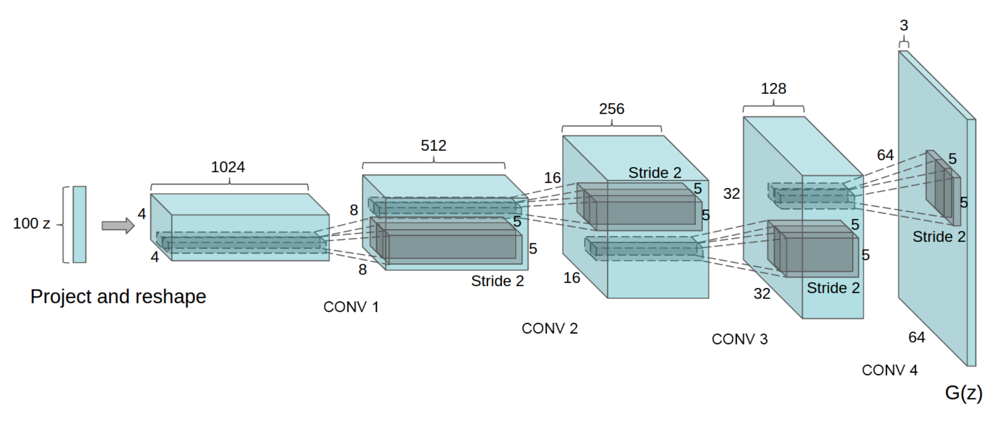

In [ ]:
Image('images/dcgan-gen.png')

Напишем класс генератора

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN, 
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''

        #     Steps:
        #       1) Do a transposed convolution using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a ReLU activation.
        #       4) If its the final layer, use a Tanh activation after the deconvolution.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()
                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh()
                #### END CODE HERE ####
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

    
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

Напишем класс дискриминатора

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
    hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN, 
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        #     Steps:
        #       1) Add a convolutional layer using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a LeakyReLU activation with slope 0.2.
        #       Note: Don't use an activation on the final layer
        
        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(negative_slope=0.2)
                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels, output_channels, kernel_size, stride)
                #### END CODE HERE ####
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

Для DCGAN дополнительно зададим хорошо себя зарекомендовавшие параметры оптимайзера $\beta_1$ и $\beta_2$, а также инициализцируем веса

In [ ]:
criterion = nn.BCEWithLogitsLoss()
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002  # A learning rate of 0.0002 works well on DCGAN

# These parameters control the optimizer's momentum
beta_1 = 0.5 
beta_2 = 0.999
device = 'cuda'

# You can tranform the image values to be between -1 and 1 (the range of the tanh activation)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [ ]:
beta_1 = 0.5 
beta_2 = 0.999

gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

# You initialize the weights to the normal distribution with mean 0 and standard deviation 0.02
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Here's roughly the progression you should be expecting. On GPU this takes about 30 seconds per thousand steps. On CPU, this can take about 8 hours per thousand steps. You might notice that in the image of Step 5000, the generator is disproprotionately producing things that look like ones. If the discriminator didn't learn to detect this imbalance quickly enough, then the generator could just produce more ones. As a result, it may have ended up tricking the discriminator so well that there would be no more improvement, known as mode collapse: 

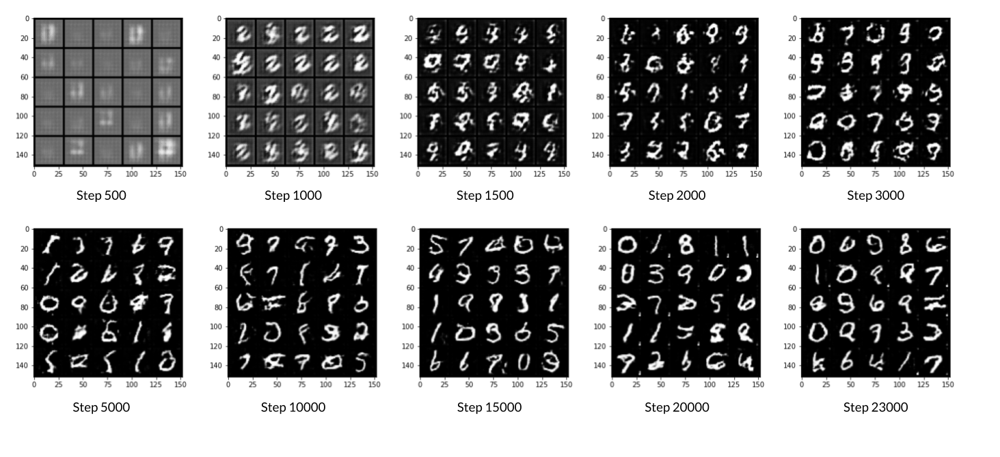

In [ ]:
Image('images/MNIST_DCGAN_Progression.png')

  0%|          | 0/50 [00:00<?, ?it/s]

Epoch 1, step 500: Generator loss: 0.7678, discriminator loss: 0.6693


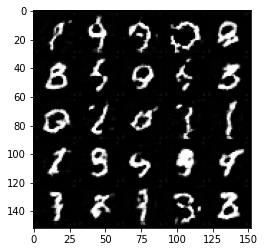

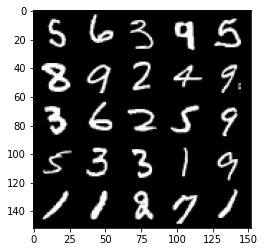

Epoch 2, step 1000: Generator loss: 0.7554, discriminator loss: 0.6731


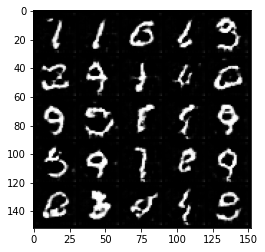

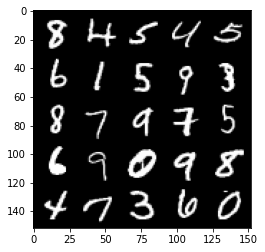

Epoch 3, step 1500: Generator loss: 0.7476, discriminator loss: 0.6776


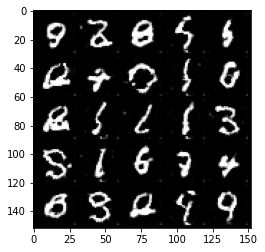

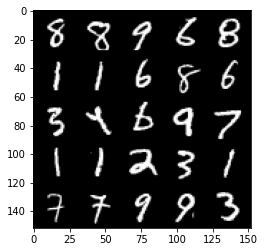

Epoch 4, step 2000: Generator loss: 0.7416, discriminator loss: 0.6793


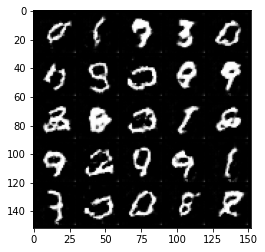

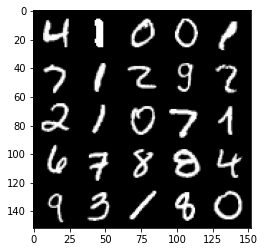

Epoch 5, step 2500: Generator loss: 0.7387, discriminator loss: 0.6830


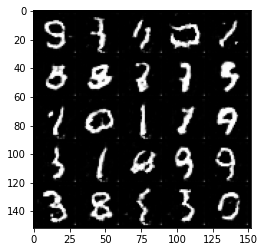

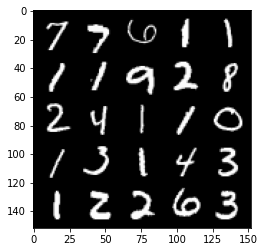

Epoch 6, step 3000: Generator loss: 0.7395, discriminator loss: 0.6856


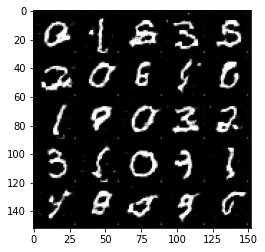

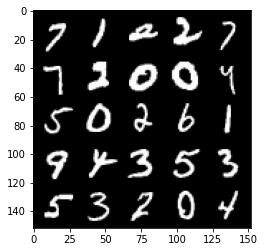

Epoch 7, step 3500: Generator loss: 0.7303, discriminator loss: 0.6889


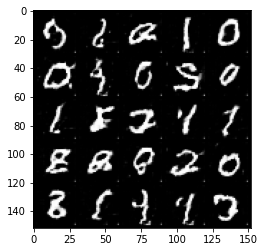

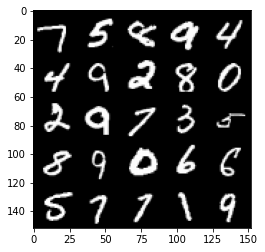

Epoch 8, step 4000: Generator loss: 0.7209, discriminator loss: 0.6927


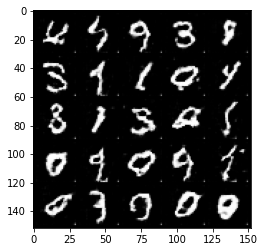

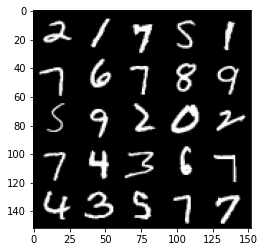

Epoch 9, step 4500: Generator loss: 0.7167, discriminator loss: 0.6950


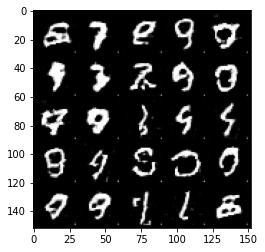

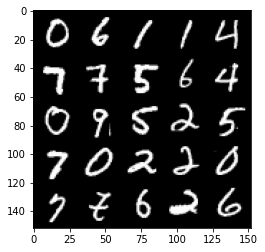

Epoch 10, step 5000: Generator loss: 0.7148, discriminator loss: 0.6960


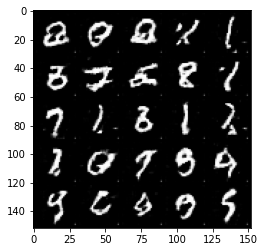

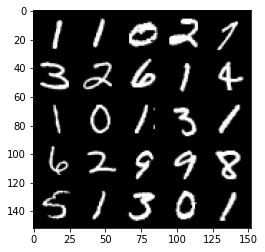

Epoch 11, step 5500: Generator loss: 0.7100, discriminator loss: 0.6968


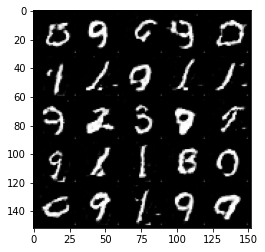

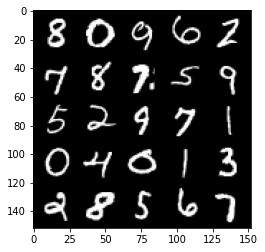

Epoch 12, step 6000: Generator loss: 0.7116, discriminator loss: 0.6970


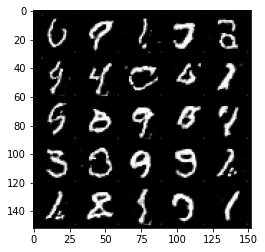

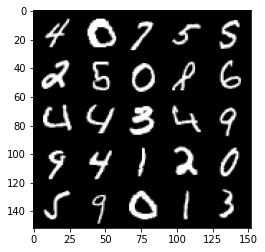

Epoch 13, step 6500: Generator loss: 0.7083, discriminator loss: 0.6967


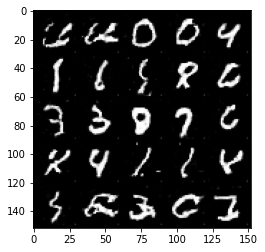

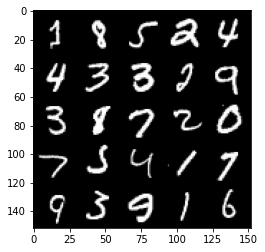

Epoch 14, step 7000: Generator loss: 0.7083, discriminator loss: 0.6977


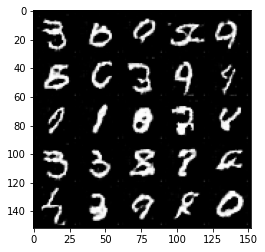

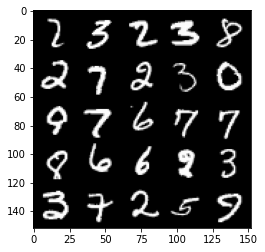

Epoch 15, step 7500: Generator loss: 0.7069, discriminator loss: 0.6975


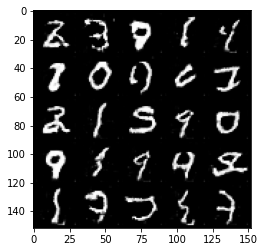

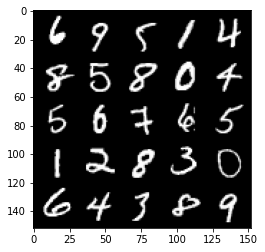

Epoch 17, step 8000: Generator loss: 0.7060, discriminator loss: 0.6978


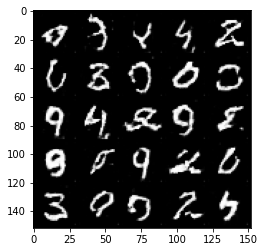

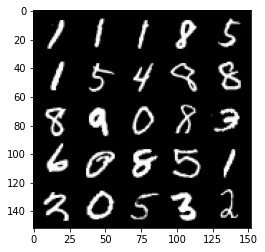

Epoch 18, step 8500: Generator loss: 0.7030, discriminator loss: 0.6980


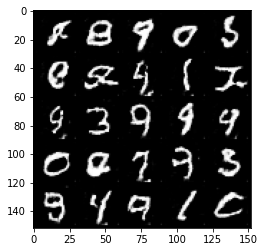

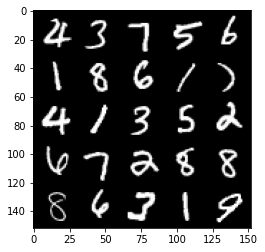

Epoch 19, step 9000: Generator loss: 0.7037, discriminator loss: 0.6979


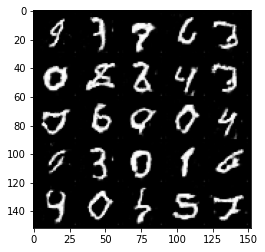

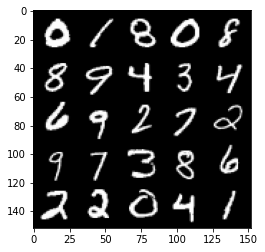

Epoch 20, step 9500: Generator loss: 0.7005, discriminator loss: 0.6978


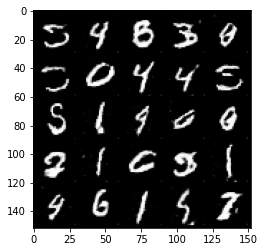

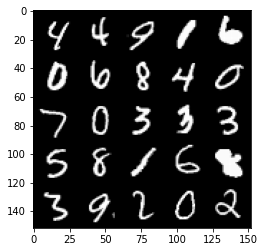

Epoch 21, step 10000: Generator loss: 0.6999, discriminator loss: 0.6976


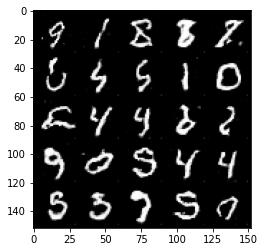

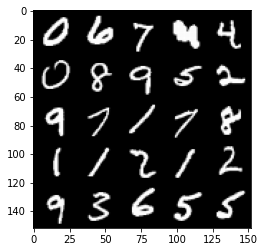

Epoch 22, step 10500: Generator loss: 0.7003, discriminator loss: 0.6980


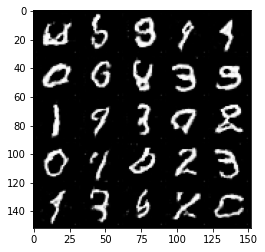

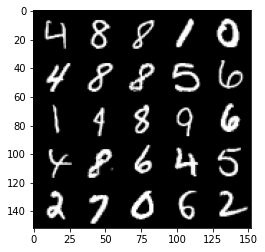

Epoch 23, step 11000: Generator loss: 0.7001, discriminator loss: 0.6977


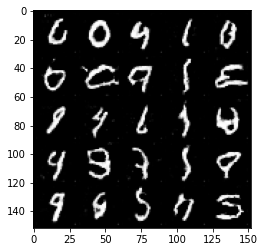

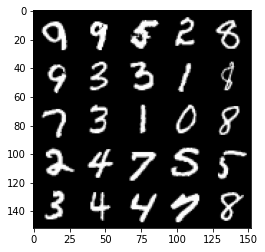

Epoch 24, step 11500: Generator loss: 0.6990, discriminator loss: 0.6978


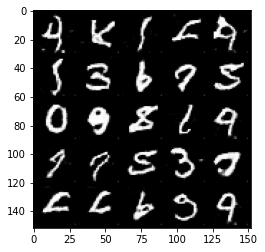

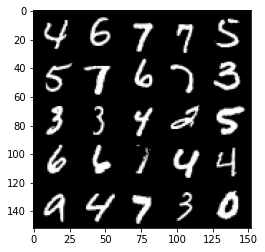

Epoch 25, step 12000: Generator loss: 0.6979, discriminator loss: 0.6974


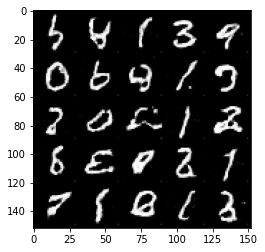

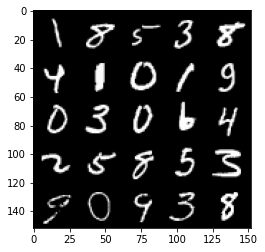

Epoch 26, step 12500: Generator loss: 0.6987, discriminator loss: 0.6970


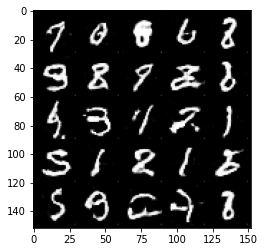

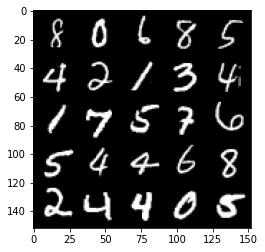

Epoch 27, step 13000: Generator loss: 0.6971, discriminator loss: 0.6971


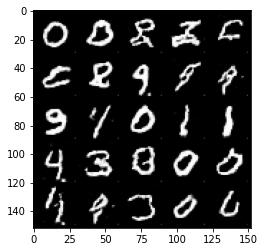

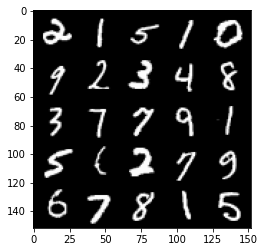

Epoch 28, step 13500: Generator loss: 0.6970, discriminator loss: 0.6967


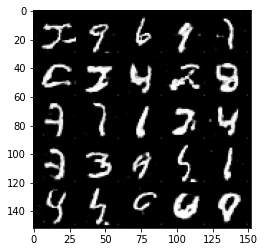

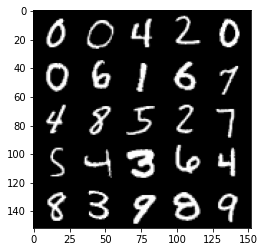

Epoch 29, step 14000: Generator loss: 0.6983, discriminator loss: 0.6971


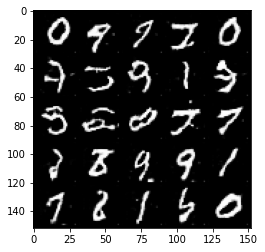

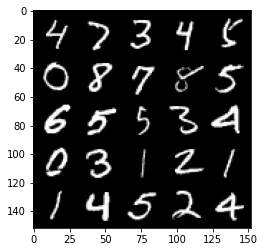

Epoch 30, step 14500: Generator loss: 0.6973, discriminator loss: 0.6966


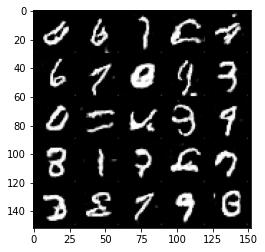

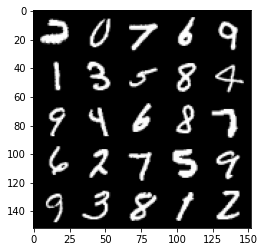

Epoch 31, step 15000: Generator loss: 0.6960, discriminator loss: 0.6965


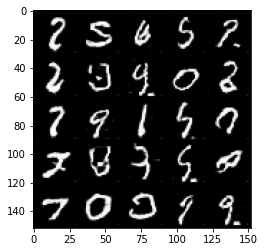

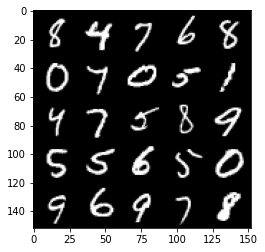

Epoch 33, step 15500: Generator loss: 0.6964, discriminator loss: 0.6964


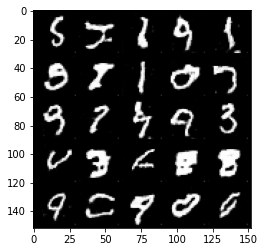

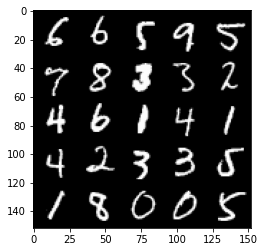

Epoch 34, step 16000: Generator loss: 0.6962, discriminator loss: 0.6961


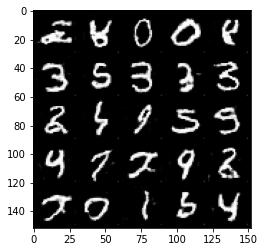

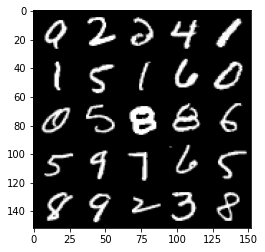

Epoch 35, step 16500: Generator loss: 0.6973, discriminator loss: 0.6960


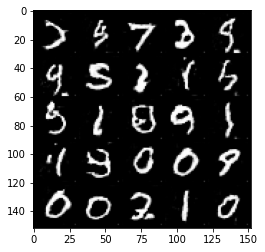

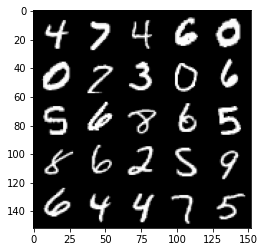

Epoch 36, step 17000: Generator loss: 0.6963, discriminator loss: 0.6957


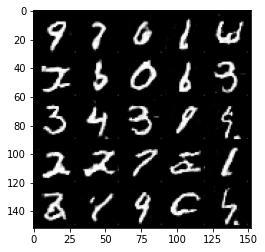

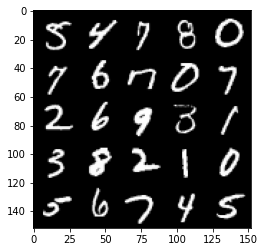

Epoch 37, step 17500: Generator loss: 0.6961, discriminator loss: 0.6957


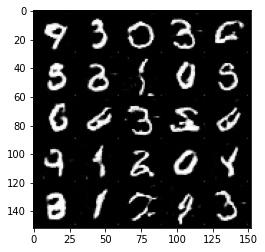

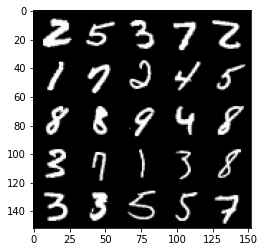

Epoch 38, step 18000: Generator loss: 0.6951, discriminator loss: 0.6954


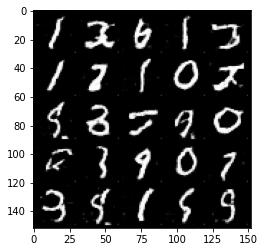

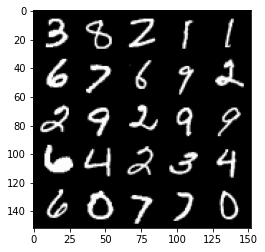

Epoch 39, step 18500: Generator loss: 0.6960, discriminator loss: 0.6956


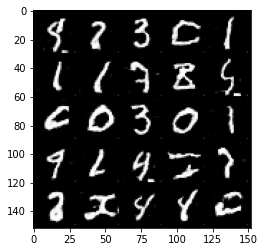

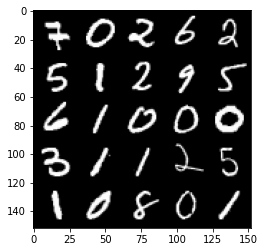

Epoch 40, step 19000: Generator loss: 0.6957, discriminator loss: 0.6952


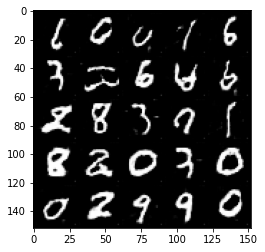

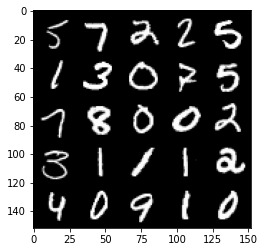

Epoch 41, step 19500: Generator loss: 0.6957, discriminator loss: 0.6951


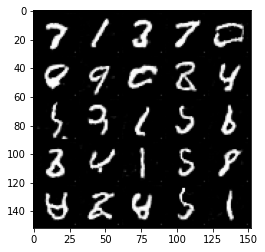

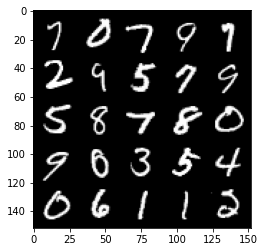

Epoch 42, step 20000: Generator loss: 0.6961, discriminator loss: 0.6952


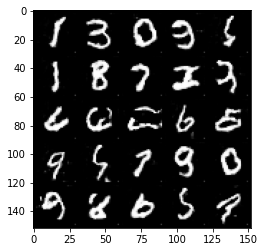

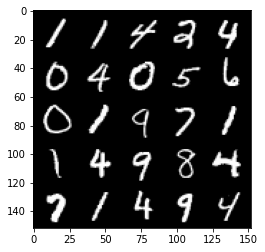

Epoch 43, step 20500: Generator loss: 0.6965, discriminator loss: 0.6950


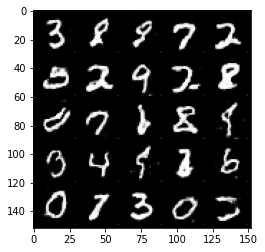

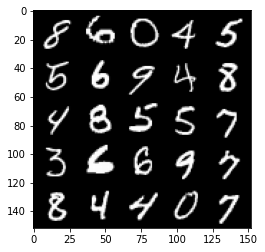

Epoch 44, step 21000: Generator loss: 0.6947, discriminator loss: 0.6948


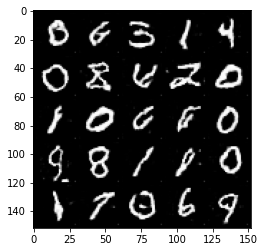

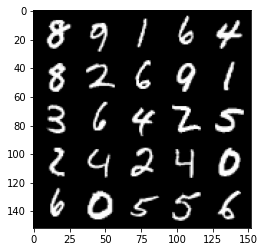

Epoch 45, step 21500: Generator loss: 0.6957, discriminator loss: 0.6948


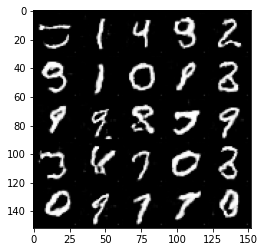

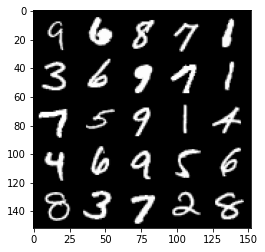

Epoch 46, step 22000: Generator loss: 0.6950, discriminator loss: 0.6947


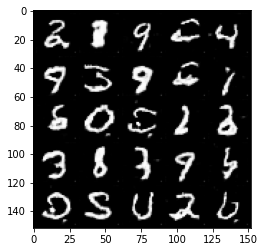

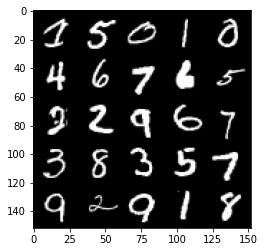

Epoch 47, step 22500: Generator loss: 0.6962, discriminator loss: 0.6946


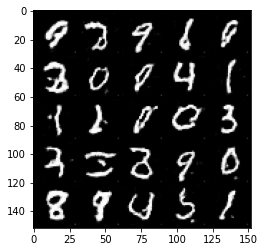

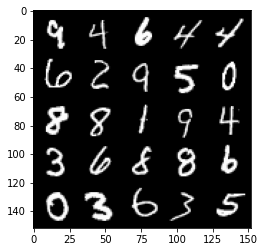

Epoch 49, step 23000: Generator loss: 0.6960, discriminator loss: 0.6948


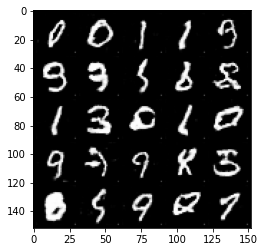

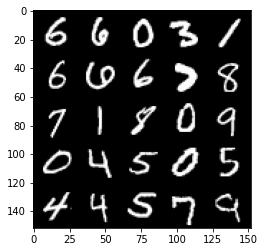

In [ ]:
n_epochs = 50
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
for epoch in tqdm(range(n_epochs)):
    # Dataloader returns the batches
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss:.4f}, discriminator loss: {mean_discriminator_loss:.4f}")
            show_tensor_images(fake, dcgan=True)
            show_tensor_images(real, dcgan=True)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1

The standard autoencoder can have an issue, constituted by the fact that the latent space can be irregular [1]. This means that close points in the latent space can produce different and meaningless patterns over visible units.

One solution to this issue is the introduction of the Variational Autoencoder. As the autoencoder, it is composed of two neural network architectures, encoder and decoder.